# **Tarea 6: Ejercicio usando las técnicas de aprendizaje no supervisado de reducción de dimensionalidad y agrupación**

**Objetivo:** Implementar un clasificador no supervisado que maximice el desempeño de clusterización sobre el espacio original de los datos y los espacios reducidos con técnicas no lineales (Isomap y MDS).

## **Cargar el Dataset**

In [ ]:
!wget -O dataset_wq.xlsx 'https://raw.githubusercontent.com/Negatix092/DM1/bcd52726a66c65ab6d4ebeea6401517aa439ce73/UL_Clustering/dataset(wq).xlsx'

--2024-11-01 00:11:01--  https://raw.githubusercontent.com/Negatix092/DM1/bcd52726a66c65ab6d4ebeea6401517aa439ce73/UL_Clustering/dataset(wq).xlsx
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 104921 (102K) [application/octet-stream]
Saving to: ‘dataset_wq.xlsx’

dataset_wq.xlsx     100%[===================>] 102.46K  --.-KB/s    in 0.004s  

2024-11-01 00:11:01 (23.8 MB/s) - ‘dataset_wq.xlsx’ saved [104921/104921]



## **Crear Dataframe**

In [32]:
import pandas as pd

df = pd.read_excel('dataset_wq.xlsx')
df.head()

,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4


## **Reducción de Dimensionalidad con Isomap y MDS**

* Implementar las dos técnicas de reducción de dimensionalidad (Isomap y MDS) y aplicarlas sobre al dataset de trabajo para obtener los espacios reducidos, dependiendo de la variación del número de componentes y otros parámetros internos de cada método.

  Se debe variar el parámetro de número de
componentes al menos 3 veces para facilitar la búsqueda del mejor espacio
reducido (ej: n_components = 3,5,7). Otros parámetros internos de cada método
se pueden variar a su elección (ej: número de vecinos en el Isomap = 5,10).
Mostrar los gráficos de los espacios reducidos para cada combinación de
parámetros (Un subplot tipo grid).

In [33]:
# Instala las librerías necesarias si aún no están instaladas
#!pip install matplotlib scikit-learn pandas openpyxl

# Importa las librerías
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import Isomap, MDS
from sklearn.preprocessing import StandardScaler, MinMaxScaler

#Utilizando StandardScaler

In [58]:
from scipy.spatial import distance_matrix

# Escala los datos
scaler = StandardScaler()
data_normalized = scaler.fit_transform(df)

# Parámetros
n_components = [3, 5, 7]  # Número de componentes para cada técnica
n_neighbors_isomap = [5, 10]  # Número de vecinos para Isomap

# Diccionarios para almacenar resultados de reducción y errores
results = {}
reduction_errors = {}

# Función para aplicar Isomap y MDS con ajuste de hiperparámetros
def apply_dimensionality_reduction(data, n_components, n_neighbors_isomap):

    for n in n_components:
        # Isomap con diferentes valores de n_neighbors y método del camino más corto
        for neighbors in n_neighbors_isomap:
            isomap = Isomap(n_components=n, n_neighbors=neighbors, path_method='auto', n_jobs=-1)
            data_isomap = isomap.fit_transform(data)
            # Calcular la distorsión de distancia para Isomap como error
            original_distances = distance_matrix(data, data)
            reduced_distances = distance_matrix(data_isomap, data_isomap)
            distortion_error = np.mean(np.abs(original_distances - reduced_distances))

            results[f'Isomap (n={n}, neighbors={neighbors})'] = data_isomap
            reduction_errors[f'Isomap (n={n}, neighbors={neighbors})'] = distortion_error


        # MDS métrico y no métrico
        for metric in [True, False]:
            mds = MDS(n_components=n, metric=metric, n_init=10, max_iter=500, n_jobs=-1)
            data_mds = mds.fit_transform(data)
            # Guardar el estrés para MDS
            stress = mds.stress_
            metric_type = 'Métrico' if metric else 'No Métrico'
            results[f'MDS (n={n}, {metric_type})'] = data_mds
            reduction_errors[f'MDS (n={n}, {metric_type})'] = stress

# Aplicar reduccion de dimensionalidad
apply_dimensionality_reduction(data_normalized, n_components, n_neighbors_isomap)

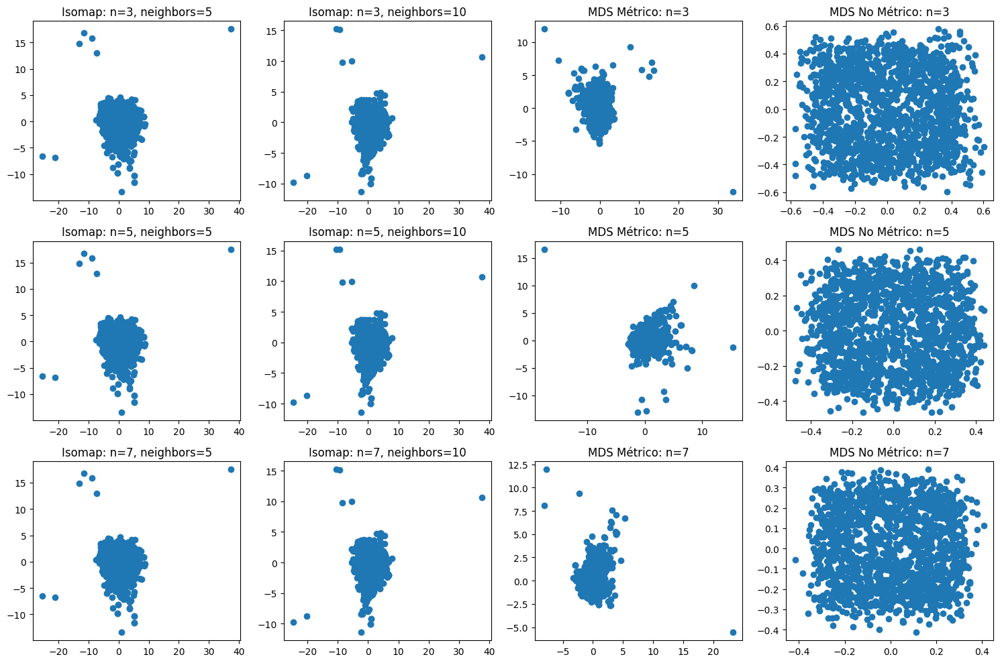

In [59]:
import matplotlib.pyplot as plt

def visualize_dimensionality_reduction_results(results, n_components, n_neighbors_isomap, figsize=(15, 10)):
    """
    Visualiza los resultados de reducción de dimensionalidad usando Isomap y MDS
    """
    fig, axs = plt.subplots(len(n_components), len(n_neighbors_isomap) + 2, figsize=figsize)

    for i, n in enumerate(n_components):
        for j, neighbors in enumerate(n_neighbors_isomap):
            ax = axs[i, j]
            data_isomap = results[f'Isomap (n={n}, neighbors={neighbors})']
            ax.scatter(data_isomap[:, 0], data_isomap[:, 1])
            ax.set_title(f'Isomap: n={n}, neighbors={neighbors}')

        # Visualizacion del MDS Metrico
        ax = axs[i, -2]
        data_mds_metric = results[f'MDS (n={n}, Métrico)']
        ax.scatter(data_mds_metric[:, 0], data_mds_metric[:, 1])
        ax.set_title(f'MDS Métrico: n={n}')

        # Visualización de MDS No Métrico
        ax = axs[i, -1]
        data_mds_nonmetric = results[f'MDS (n={n}, No Métrico)']
        ax.scatter(data_mds_nonmetric[:, 0], data_mds_nonmetric[:, 1])
        ax.set_title(f'MDS No Métrico: n={n}')

    plt.tight_layout()
    plt.show()

visualize_dimensionality_reduction_results(results, n_components, n_neighbors_isomap)

* Aplicar al menos un algoritmo de clusterización visto en clase (k-means,
Hieralchical clustering, GMM) al espacio original de los datos y a los distintos espacios reducidos obtenidos por el punto anterior para validar el desempeño de clasificación de acuerdo a las métricas no supervisadas y a la variación de la cantidad de clusters posibles (k=2..8).

# K-Means

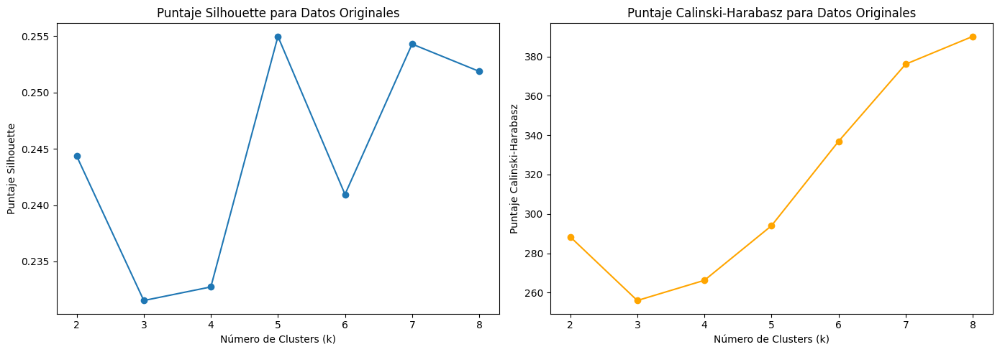

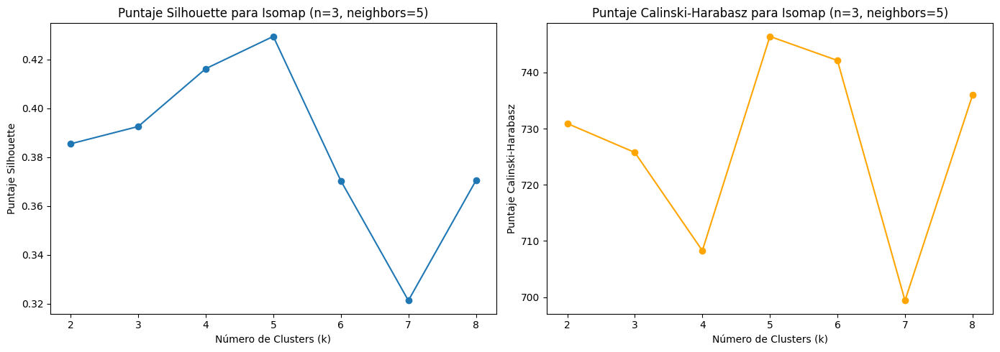

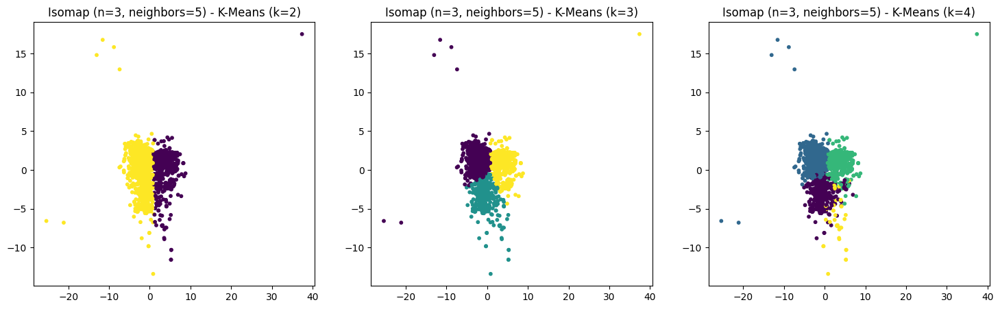

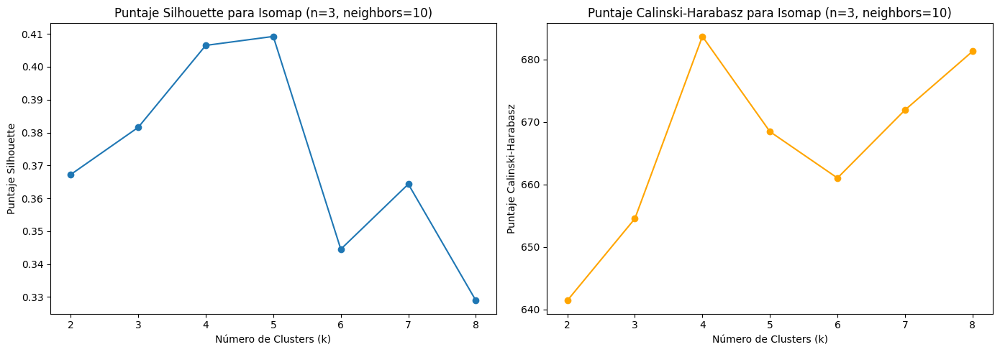

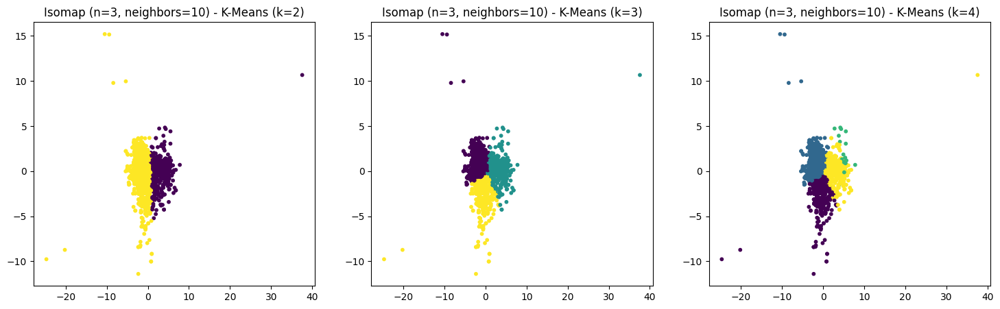

...

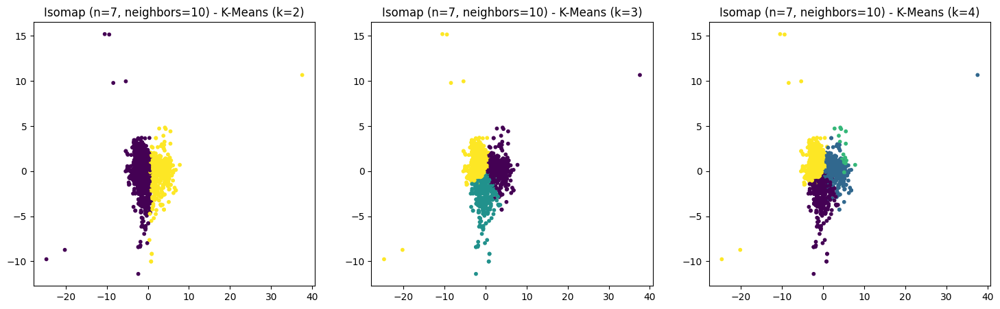

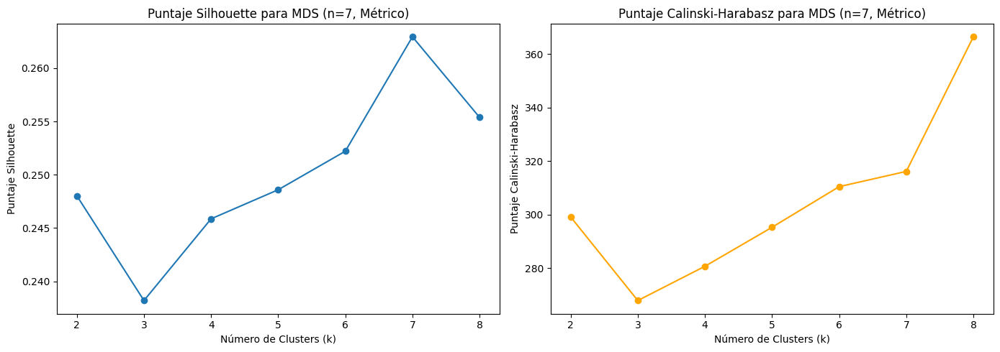

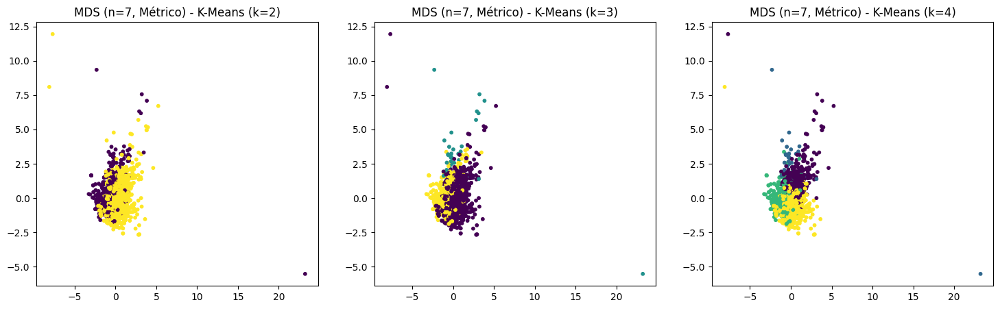

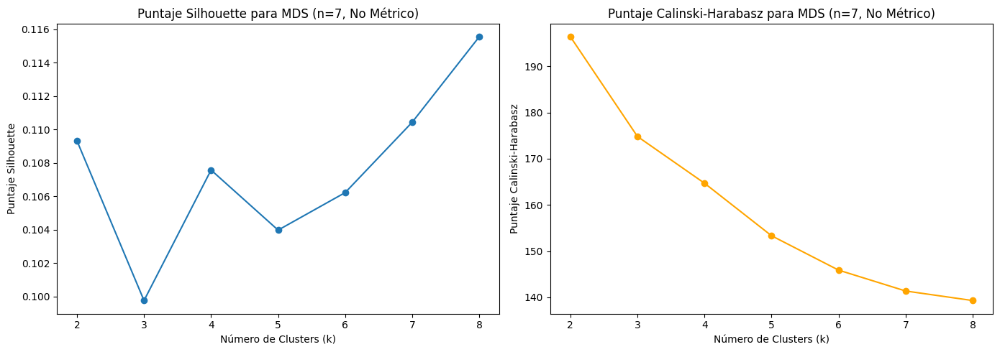

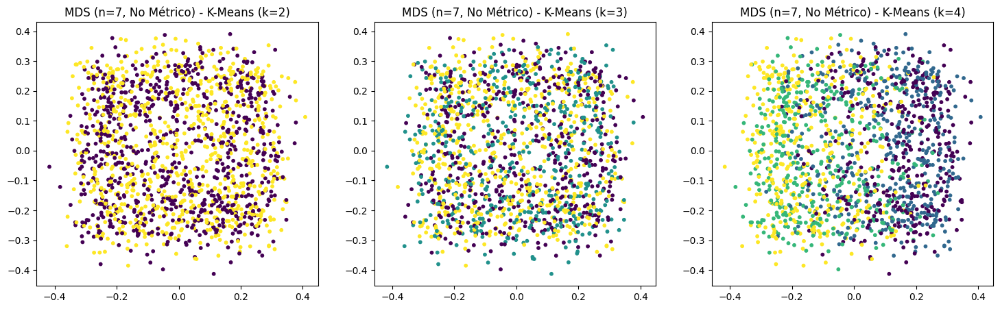

In [60]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import warnings

warnings.filterwarnings("ignore")

#Diccionaro para almacenar métricas de clustering para cada configuración
clustering_metrics = {}

# Función para aplicar K-Means y calcular métricas
def apply_clustering(data, n_clusters, reduction_key, random_state=42):
    clustering_results = {}
    for k in n_clusters:
        model = KMeans(n_clusters=k, init='k-means++', random_state=random_state)
        labels = model.fit_predict(data)
        silhouette_avg = silhouette_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
        clustering_results[k] = (labels, silhouette_avg, calinski_harabasz)

        # Almacenar las métricas en el diccionario global
        if reduction_key not in clustering_metrics:
            clustering_metrics[reduction_key] = {}
        clustering_metrics[reduction_key][k] = (silhouette_avg, calinski_harabasz)

    return clustering_results

# Función para graficar las métricas de clusterización
def plot_clustering_metrics(clustering_results, description):
    k_values = list(clustering_results.keys())
    silhouette_scores = [clustering_results[k][1] for k in k_values]
    calinski_harabasz_scores = [clustering_results[k][2] for k in k_values]

    # Crear gráficos para Silhouette y Calinski-Harabasz
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # Gráfico de Silhouette Score
    axs[0].plot(k_values, silhouette_scores, marker='o')
    axs[0].set_xlabel("Número de Clusters (k)")
    axs[0].set_ylabel("Puntaje Silhouette")
    axs[0].set_title(f"Puntaje Silhouette para {description}")

    # Gráfico de Calinski-Harabasz Score
    axs[1].plot(k_values, calinski_harabasz_scores, marker='o', color='orange')
    axs[1].set_xlabel("Número de Clusters (k)")
    axs[1].set_ylabel("Puntaje Calinski-Harabasz")
    axs[1].set_title(f"Puntaje Calinski-Harabasz para {description}")

    plt.tight_layout()
    plt.show()

# Función para graficar los resultados de la clusterización en el espacio reducido
def plot_clustering_results(ax, data_reduced, labels, title):
    ax.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis', s=10)
    ax.set_title(title)

# Función principal para aplicar reducción de dimensionalidad, clustering y visualizar resultados
def dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized):
    # Aplicar clusterización a los datos originales
    original_clustering_results = apply_clustering(data_normalized, n_clusters, "Datos Originales")
    plot_clustering_metrics(original_clustering_results, "Datos Originales")

    # Graficar los resultados para cada configuración de reducción de dimensionalidad
    for n in n_components:
        for neighbors in n_neighbors_isomap:
            key = f'Isomap (n={n}, neighbors={neighbors})'
            data_reduced = results[key]
            reduced_clustering_results = apply_clustering(data_reduced, n_clusters, key)

            # Gráficos de métricas para cada configuración
            plot_clustering_metrics(reduced_clustering_results, key)

            # Visualización de clustering en el espacio reducido para 3 valores de k (por ejemplo, k=2, k=3, y k=4)
            fig, axs = plt.subplots(1, 3, figsize=(18, 5))
            k_values_for_visuals = [2, 3, 4]
            for i, k in enumerate(k_values_for_visuals):
                labels = reduced_clustering_results[k][0]
                plot_clustering_results(axs[i], data_reduced, labels, f'{key} - K-Means (k={k})')
            plt.show()

        # MDS Métrico
        key = f'MDS (n={n}, Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - K-Means (k={k})')
        plt.show()

        # MDS No Métrico
        key = f'MDS (n={n}, No Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS No Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - K-Means (k={k})')
        plt.show()

# Parámetros de número de clusters
n_clusters = [2, 3, 4, 5, 6, 7, 8]  # Número de clusters para K-Means (puedes ajustar estos valores)

# Ejecuta la función con los resultados de reducción de dimensionalidad y clustering
dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized)

#Mejor Esquema de Clasificacion (KMeans)

In [61]:
# Función para encontrar el mejor esquema de clustering
def find_best_scheme_kmeans(clustering_metrics, reduction_errors):
    best_scheme = None
    best_score = -np.inf

    for reduction_key, metrics in clustering_metrics.items():
        # Obtiene el error de reducción de dimensionalidad
        reduction_error = reduction_errors.get(reduction_key, 0)

        for k, (silhouette_avg, calinski_harabasz) in metrics.items():
            # Calcular un puntaje combinado para cada esquema (mayor es mejor)
            score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

            # Actualiza el mejor esquema si encuentra un puntaje más alto
            if score > best_score:
                best_score = score
                best_scheme = (reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_scheme

# Encuentra el mejor esquema de clasificación
best_scheme_kmeans = find_best_scheme_kmeans(clustering_metrics, reduction_errors)

# Muestra el mejor esquema encontrado
print("Mejor esquema de clasificación (KMeans):")
print(f"Reducción de Dimensionalidad: {best_scheme_kmeans[0]}")
print(f"Número de Clusters (k): {best_scheme_kmeans[1]}")
print(f"Puntaje Silhouette Promedio: {best_scheme_kmeans[2]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_scheme_kmeans[3]:.2f}")
print(f"Error de Reducción: {best_scheme_kmeans[4]:.2f}")

Mejor esquema de clasificación (KMeans):
Reducción de Dimensionalidad: Isomap (n=3, neighbors=5)
Número de Clusters (k): 5
Puntaje Silhouette Promedio: 0.43
Puntaje Calinski-Harabasz Promedio: 746.43
Error de Reducción: 2.03


# Hieralchical Clustering

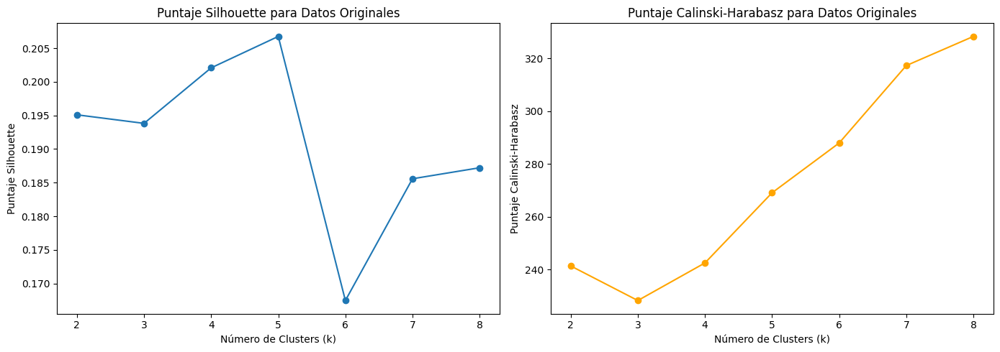

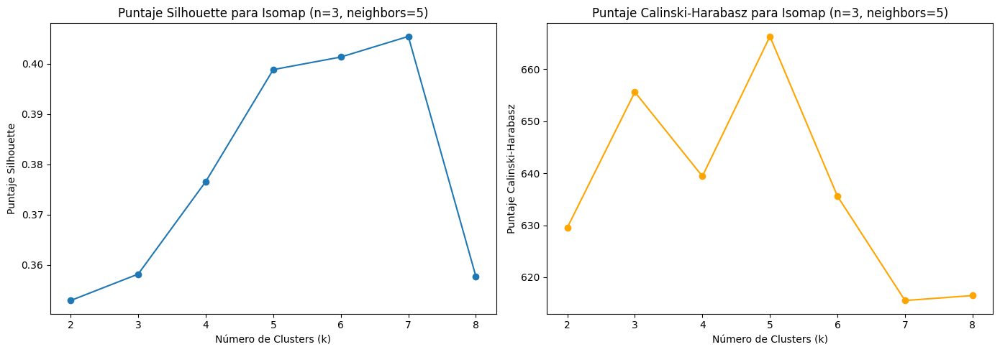

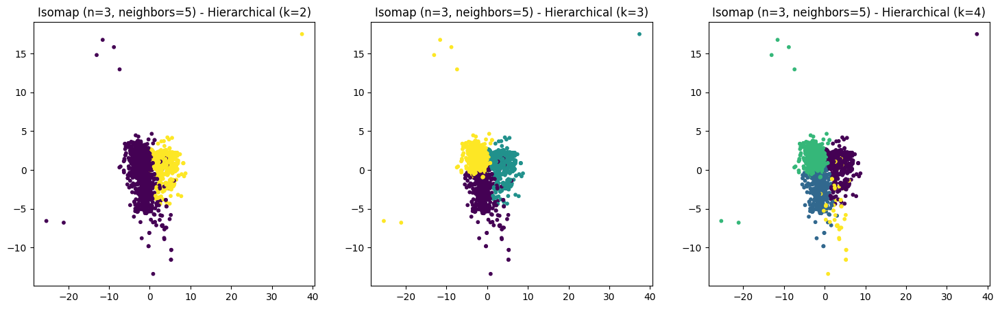

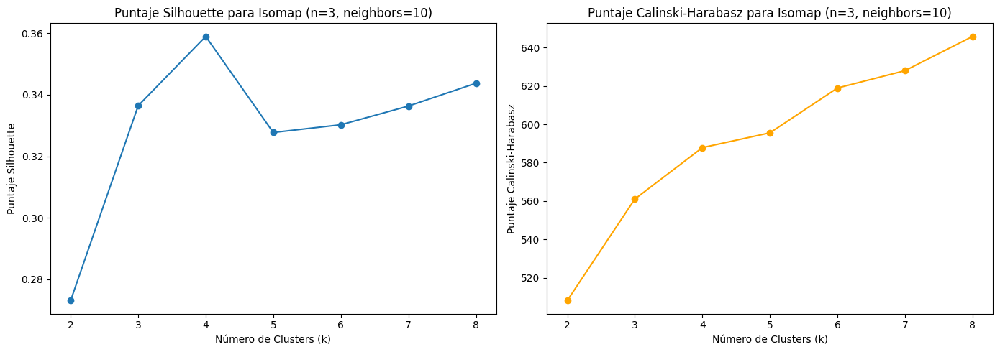

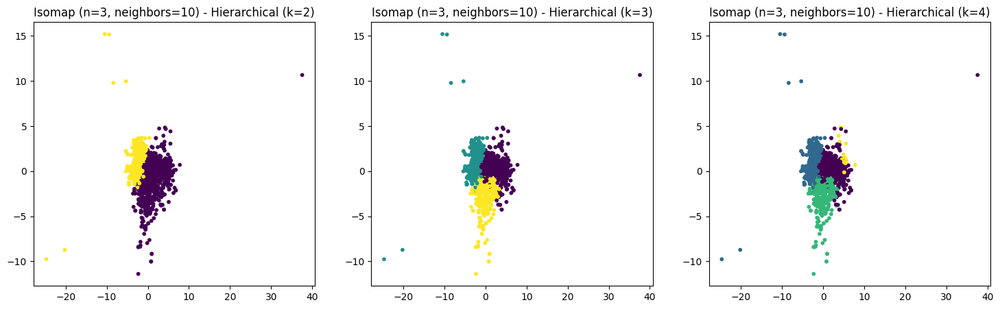

...

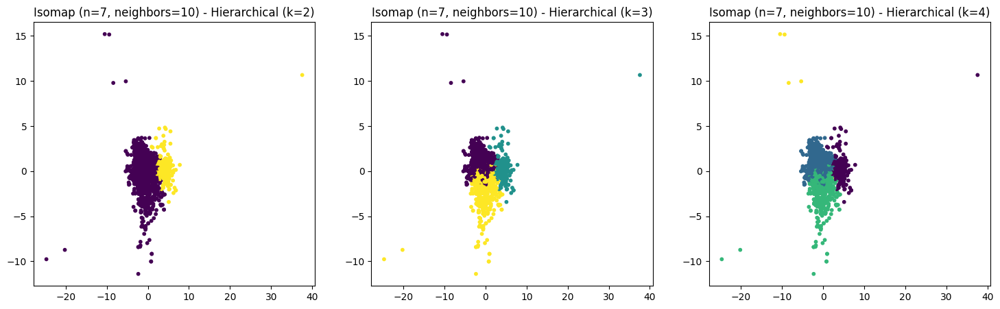

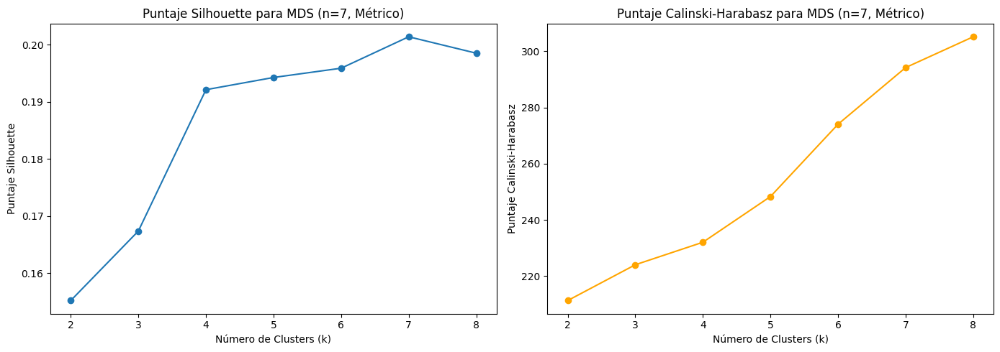

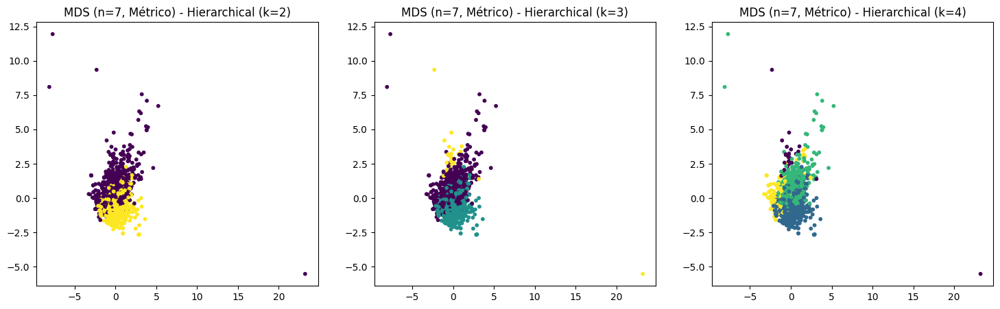

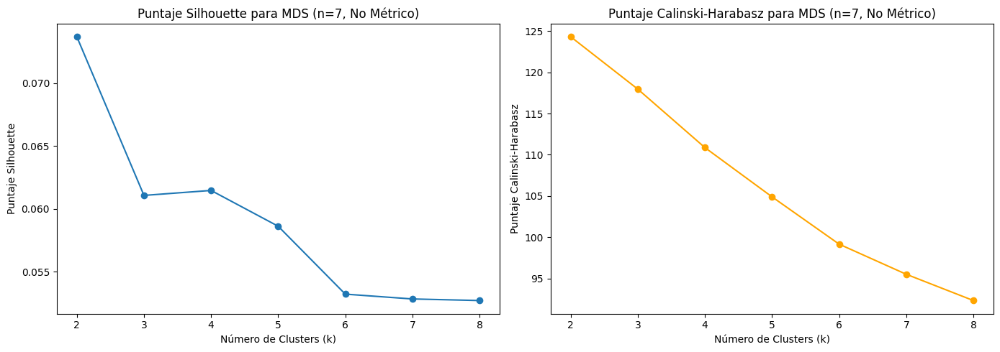

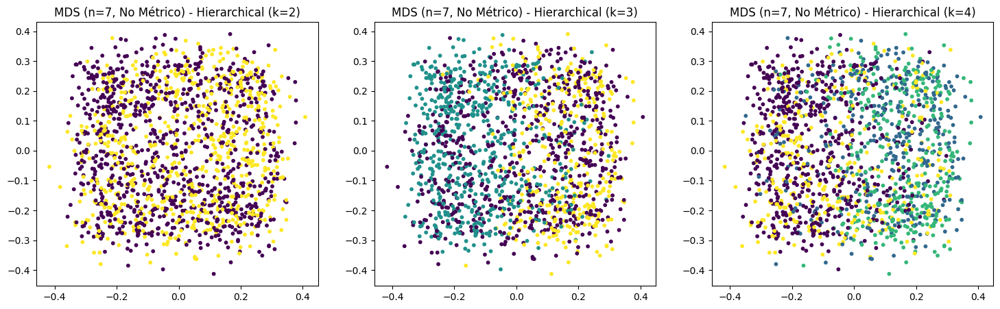

In [62]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import warnings

warnings.filterwarnings("ignore")

# Diccionario para almacenar métricas de clustering para cada configuración
clustering_metrics_hierarchical = {}

# Función para aplicar Hierarchical Clustering y calcular métricas
def apply_hierarchical_clustering(data, n_clusters, reduction_key):
    clustering_results = {}
    for k in n_clusters:
        model = AgglomerativeClustering(n_clusters=k)
        labels = model.fit_predict(data)
        silhouette_avg = silhouette_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
        clustering_results[k] = (labels, silhouette_avg, calinski_harabasz)

        # Almacenar las métricas en el diccionario global
        if reduction_key not in clustering_metrics_hierarchical:
            clustering_metrics_hierarchical[reduction_key] = {}
        clustering_metrics_hierarchical[reduction_key][k] = (silhouette_avg, calinski_harabasz)

    return clustering_results

# Función para graficar las métricas de clusterización
def plot_clustering_metrics(clustering_results, description):
    k_values = list(clustering_results.keys())
    silhouette_scores = [clustering_results[k][1] for k in k_values]
    calinski_harabasz_scores = [clustering_results[k][2] for k in k_values]

    # Crear gráficos para Silhouette y Calinski-Harabasz
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # Gráfico de Silhouette Score
    axs[0].plot(k_values, silhouette_scores, marker='o')
    axs[0].set_xlabel("Número de Clusters (k)")
    axs[0].set_ylabel("Puntaje Silhouette")
    axs[0].set_title(f"Puntaje Silhouette para {description}")

    # Gráfico de Calinski-Harabasz Score
    axs[1].plot(k_values, calinski_harabasz_scores, marker='o', color='orange')
    axs[1].set_xlabel("Número de Clusters (k)")
    axs[1].set_ylabel("Puntaje Calinski-Harabasz")
    axs[1].set_title(f"Puntaje Calinski-Harabasz para {description}")

    plt.tight_layout()
    plt.show()

# Función para graficar los resultados de la clusterización en el espacio reducido
def plot_clustering_results(ax, data_reduced, labels, title):
    ax.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis', s=10)
    ax.set_title(title)

# Función principal para aplicar reducción de dimensionalidad, clustering y visualizar resultados
def dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized):
    # Aplicar clusterización a los datos originales
    original_clustering_results = apply_hierarchical_clustering(data_normalized, n_clusters, "Datos Originales")
    plot_clustering_metrics(original_clustering_results, "Datos Originales")

    # Graficar los resultados para cada configuración de reducción de dimensionalidad
    for n in n_components:
        for neighbors in n_neighbors_isomap:
            key = f'Isomap (n={n}, neighbors={neighbors})'
            data_reduced = results[key]
            reduced_clustering_results = apply_hierarchical_clustering(data_reduced, n_clusters, key)

            # Gráficos de métricas para cada configuración
            plot_clustering_metrics(reduced_clustering_results, key)

            # Visualización de clustering en el espacio reducido para 3 valores de k (por ejemplo, k=2, k=3, y k=4)
            fig, axs = plt.subplots(1, 3, figsize=(18, 5))
            k_values_for_visuals = [2, 3, 4]
            for i, k in enumerate(k_values_for_visuals):
                labels = reduced_clustering_results[k][0]
                plot_clustering_results(axs[i], data_reduced, labels, f'{key} - Hierarchical (k={k})')
            plt.show()

        # MDS Métrico
        key = f'MDS (n={n}, Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_hierarchical_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - Hierarchical (k={k})')
        plt.show()

        # MDS No Métrico
        key = f'MDS (n={n}, No Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_hierarchical_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS No Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - Hierarchical (k={k})')
        plt.show()

# Parámetros de número de clusters
n_clusters = [2, 3, 4, 5, 6, 7, 8]  # Número de clusters para Agglomerative Clustering

# Ejecuta la función con los resultados de reducción de dimensionalidad y clustering
dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized)

#Mejor Esquema de Clasificacion (Hierarchical)

In [63]:
# Función para encontrar el mejor esquema de clustering
def find_best_scheme_hierarchical(clustering_metrics_hierarchical, reduction_errors):
    best_scheme = None
    best_score = -np.inf

    for reduction_key, metrics in clustering_metrics_hierarchical.items():
        # Obtiene el error de reducción de dimensionalidad
        reduction_error = reduction_errors.get(reduction_key, 0)

        for k, (silhouette_avg, calinski_harabasz) in metrics.items():
            # Calcular un puntaje combinado para cada esquema (mayor es mejor)
            score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

            # Actualiza el mejor esquema si encuentra un puntaje más alto
            if score > best_score:
                best_score = score
                best_scheme = (reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_scheme

# Encuentra el mejor esquema de clasificación
best_scheme_hierarchical = find_best_scheme_hierarchical(clustering_metrics_hierarchical, reduction_errors)

# Muestra el mejor esquema encontrado
print("Mejor esquema de clasificación (Hierarchical):")
print(f"Reducción de Dimensionalidad: {best_scheme_hierarchical[0]}")
print(f"Número de Clusters (k): {best_scheme_hierarchical[1]}")
print(f"Puntaje Silhouette Promedio: {best_scheme_hierarchical[2]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_scheme_hierarchical[3]:.2f}")
print(f"Error de Reducción: {best_scheme_hierarchical[4]:.2f}")

Mejor esquema de clasificación (Hierarchical):
Reducción de Dimensionalidad: Isomap (n=3, neighbors=5)
Número de Clusters (k): 5
Puntaje Silhouette Promedio: 0.40
Puntaje Calinski-Harabasz Promedio: 666.29
Error de Reducción: 2.03


# GMM

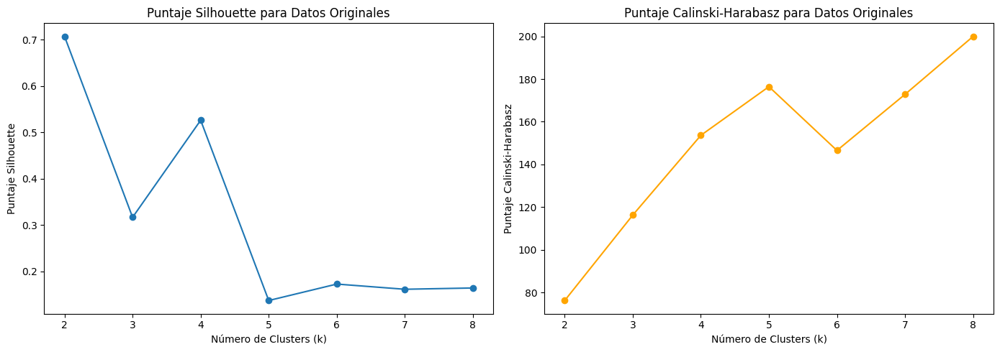

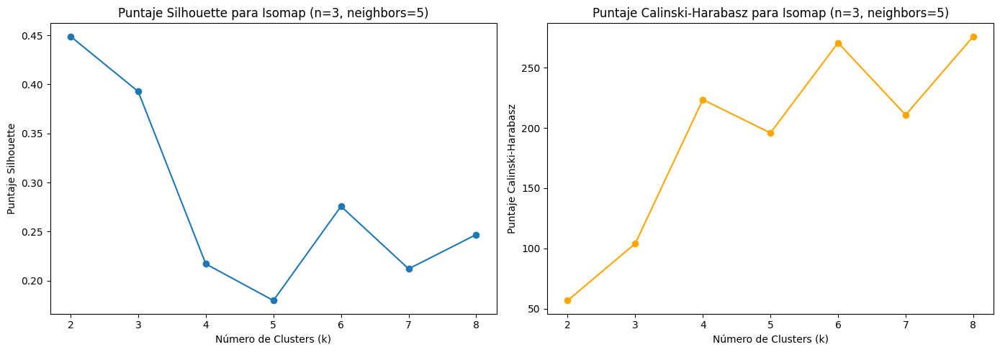

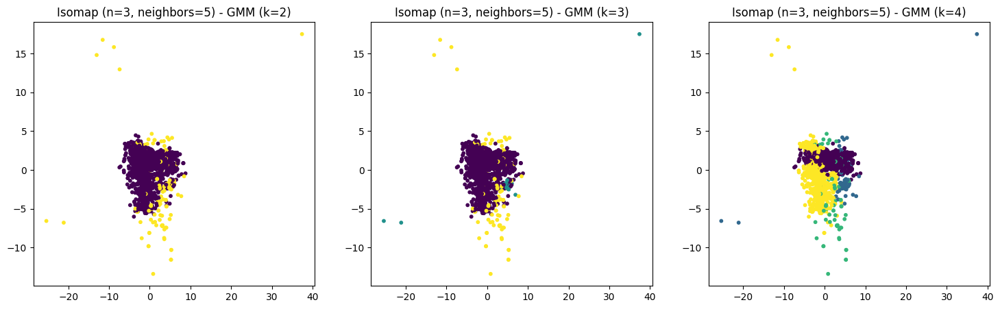

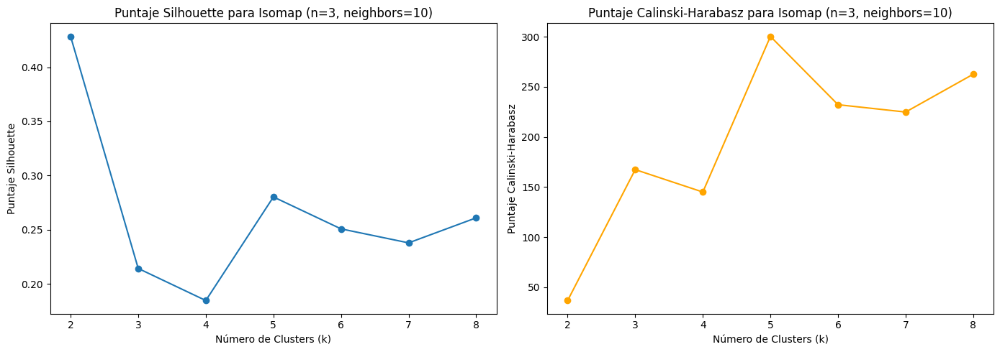

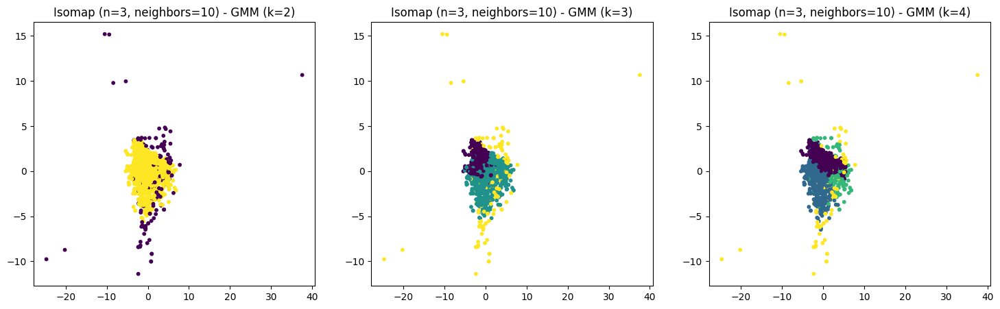

...

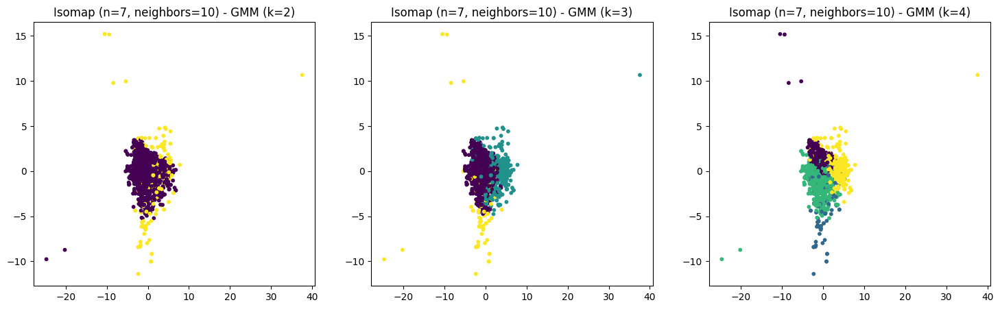

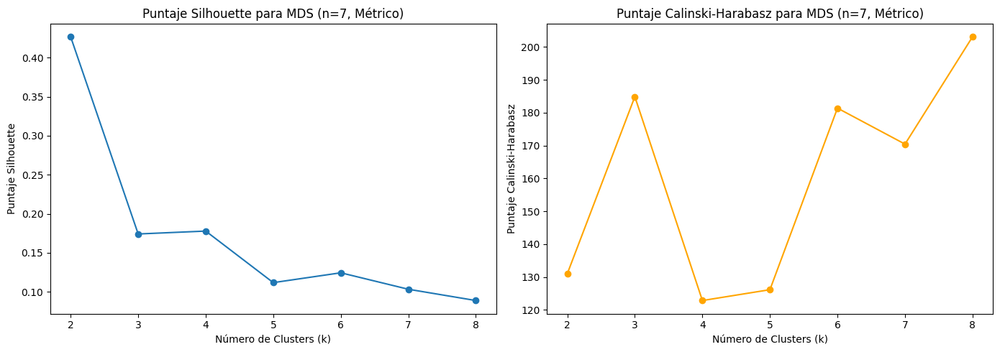

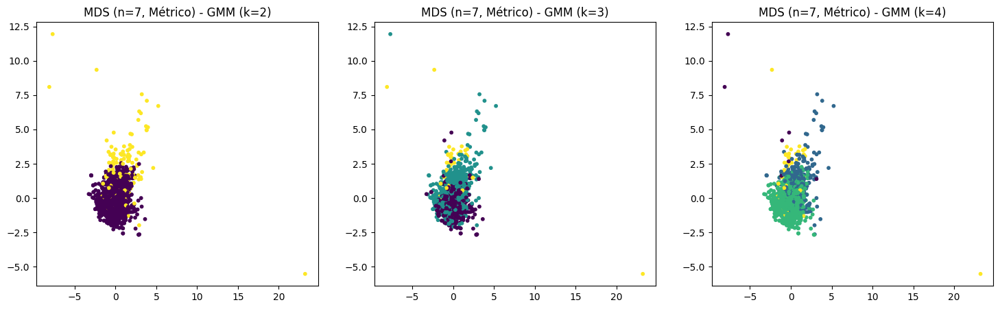

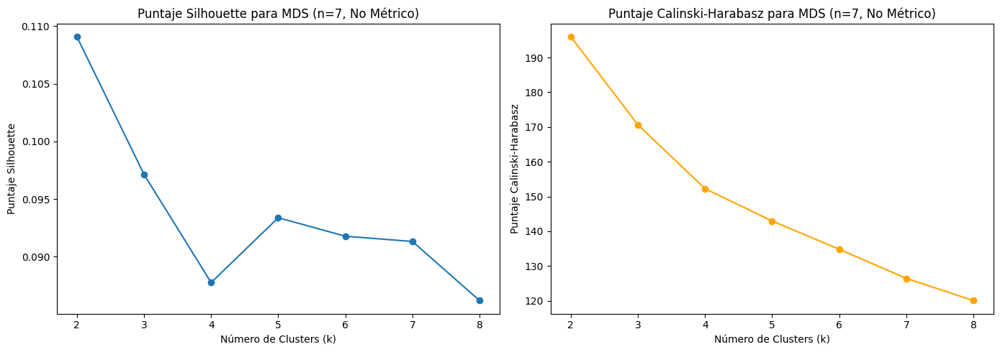

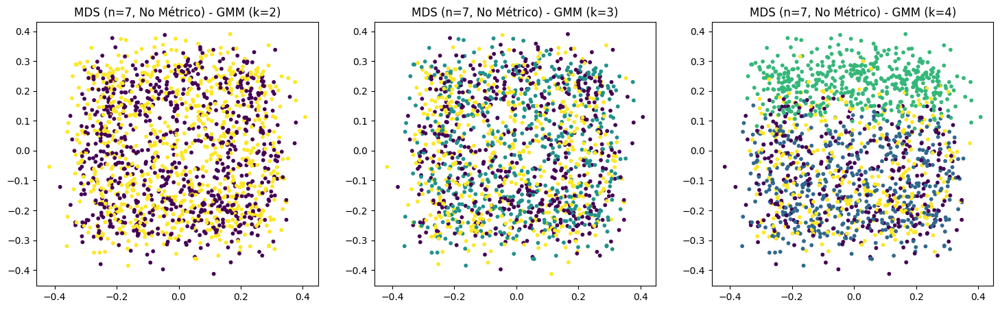

In [64]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import warnings

warnings.filterwarnings("ignore")

# Diccionario para almacenar métricas de clustering para cada configuración
clustering_metrics_gmm = {}

# Función para aplicar Gaussian Mixture Models (GMM) y calcular métricas
def apply_gmm_clustering(data, n_clusters, reduction_key, random_state=42):
    clustering_results = {}
    for k in n_clusters:
        model = GaussianMixture(n_components=k, random_state=random_state)
        labels = model.fit_predict(data)
        silhouette_avg = silhouette_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
        clustering_results[k] = (labels, silhouette_avg, calinski_harabasz)

        # Almacenar las métricas en el diccionario global
        if reduction_key not in clustering_metrics_gmm:
            clustering_metrics_gmm[reduction_key] = {}
        clustering_metrics_gmm[reduction_key][k] = (silhouette_avg, calinski_harabasz)

    return clustering_results

# Función para graficar las métricas de clusterización
def plot_clustering_metrics(clustering_results, description):
    k_values = list(clustering_results.keys())
    silhouette_scores = [clustering_results[k][1] for k in k_values]
    calinski_harabasz_scores = [clustering_results[k][2] for k in k_values]

    # Crear gráficos para Silhouette y Calinski-Harabasz
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # Gráfico de Silhouette Score
    axs[0].plot(k_values, silhouette_scores, marker='o')
    axs[0].set_xlabel("Número de Clusters (k)")
    axs[0].set_ylabel("Puntaje Silhouette")
    axs[0].set_title(f"Puntaje Silhouette para {description}")

    # Gráfico de Calinski-Harabasz Score
    axs[1].plot(k_values, calinski_harabasz_scores, marker='o', color='orange')
    axs[1].set_xlabel("Número de Clusters (k)")
    axs[1].set_ylabel("Puntaje Calinski-Harabasz")
    axs[1].set_title(f"Puntaje Calinski-Harabasz para {description}")

    plt.tight_layout()
    plt.show()

# Función para graficar los resultados de la clusterización en el espacio reducido
def plot_clustering_results(ax, data_reduced, labels, title):
    ax.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis', s=10)
    ax.set_title(title)

# Función principal para aplicar reducción de dimensionalidad, clustering y visualizar resultados
def dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized):
    # Aplicar clusterización a los datos originales
    original_clustering_results = apply_gmm_clustering(data_normalized, n_clusters, "Datos Originales")
    plot_clustering_metrics(original_clustering_results, "Datos Originales")

    # Graficar los resultados para cada configuración de reducción de dimensionalidad
    for n in n_components:
        for neighbors in n_neighbors_isomap:
            key = f'Isomap (n={n}, neighbors={neighbors})'
            data_reduced = results[key]
            reduced_clustering_results = apply_gmm_clustering(data_reduced, n_clusters, key)

            # Gráficos de métricas para cada configuración
            plot_clustering_metrics(reduced_clustering_results, key)

            # Visualización de clustering en el espacio reducido para 3 valores de k (por ejemplo, k=2, k=3, y k=4)
            fig, axs = plt.subplots(1, 3, figsize=(18, 5))
            k_values_for_visuals = [2, 3, 4]
            for i, k in enumerate(k_values_for_visuals):
                labels = reduced_clustering_results[k][0]
                plot_clustering_results(axs[i], data_reduced, labels, f'{key} - GMM (k={k})')
            plt.show()

        # MDS Métrico
        key = f'MDS (n={n}, Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_gmm_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - GMM (k={k})')
        plt.show()

        # MDS No Métrico
        key = f'MDS (n={n}, No Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_gmm_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS No Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - GMM (k={k})')
        plt.show()

# Parámetros de número de clusters
n_clusters = [2, 3, 4, 5, 6, 7, 8]  # Número de clusters para GMM

# Ejecuta la función con los resultados de reducción de dimensionalidad y clustering
dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized)

#Mejor Esquema de Clasificacion (GMM)

In [65]:
# Función para encontrar el mejor esquema de clustering para GMM
def find_best_scheme_gmm(clustering_metrics_gmm, reduction_errors):
    best_scheme = None
    best_score = -np.inf

    for reduction_key, metrics in clustering_metrics_gmm.items():
        # Obtiene el error de reducción de dimensionalidad
        reduction_error = reduction_errors.get(reduction_key, 0)

        for k, (silhouette_avg, calinski_harabasz) in metrics.items():
            # Calcular un puntaje combinado para cada esquema (mayor es mejor)
            score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

            # Actualiza el mejor esquema si encuentra un puntaje más alto
            if score > best_score:
                best_score = score
                best_scheme = (reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_scheme

# Encuentra el mejor esquema de clasificación en GMM
best_scheme_gmm = find_best_scheme_gmm(clustering_metrics_gmm, reduction_errors)

# Muestra el mejor esquema encontrado
print("Mejor esquema de clasificación (GMM):")
print(f"Reducción de Dimensionalidad: {best_scheme_gmm[0]}")
print(f"Número de Clusters (k): {best_scheme_gmm[1]}")
print(f"Puntaje Silhouette Promedio: {best_scheme_gmm[2]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_scheme_gmm[3]:.2f}")
print(f"Error de Reducción: {best_scheme_gmm[4]:.2f}")

Mejor esquema de clasificación (GMM):
Reducción de Dimensionalidad: Isomap (n=5, neighbors=5)
Número de Clusters (k): 7
Puntaje Silhouette Promedio: 0.20
Puntaje Calinski-Harabasz Promedio: 328.88
Error de Reducción: 2.54


* Determinar cuál es el mejor esquema de clasificación (modelo de reducción + método de clusterización) de los datos entre todos los evaluados.

#Mejor Esquema de Clasificacion (Overall)

In [66]:
# Función para encontrar el mejor esquema entre los tres algoritmos de clustering
def find_overall_best_scheme(best_scheme_kmeans, best_scheme_hierarchical, best_scheme_gmm):
    # Inicializa variables para el mejor esquema general
    best_overall_scheme = None
    best_score = -np.inf

    # Diccionario con los resultados de los mejores esquemas para cada algoritmo
    best_schemes = {
        "KMeans": best_scheme_kmeans,
        "Hierarchical": best_scheme_hierarchical,
        "GMM": best_scheme_gmm
    }

    # Itera sobre cada esquema y calcula el puntaje combinado para cada uno
    for algorithm, scheme in best_schemes.items():
        reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error = scheme
        score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

        # Verifica si este esquema es mejor que el actual mejor esquema
        if score > best_score:
            best_score = score
            best_overall_scheme = (algorithm, reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_overall_scheme

# Encuentra el mejor esquema entre los resultados de KMeans, Hierarchical y GMM
best_overall_scheme = find_overall_best_scheme(best_scheme_kmeans, best_scheme_hierarchical, best_scheme_gmm)

# Muestra el mejor esquema general encontrado
print("Mejor esquema de clasificación entre los tres algoritmos:")
print(f"Algoritmo: {best_overall_scheme[0]}")
print(f"Reducción de Dimensionalidad: {best_overall_scheme[1]}")
print(f"Número de Clusters (k): {best_overall_scheme[2]}")
print(f"Puntaje Silhouette Promedio: {best_overall_scheme[3]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_overall_scheme[4]:.2f}")
print(f"Error de Reducción: {best_overall_scheme[5]:.2f}")

Mejor esquema de clasificación entre los tres algoritmos:
Algoritmo: KMeans
Reducción de Dimensionalidad: Isomap (n=3, neighbors=5)
Número de Clusters (k): 5
Puntaje Silhouette Promedio: 0.43
Puntaje Calinski-Harabasz Promedio: 746.43
Error de Reducción: 2.03




---



#Utilizando MinMax

In [43]:
from scipy.spatial import distance_matrix

scaler2 = MinMaxScaler(feature_range=(0, 1))
data_normalized = scaler2.fit_transform(df)

# Parámetros
n_components = [3, 5, 7]  # Número de componentes para cada técnica
n_neighbors_isomap = [5, 10]  # Número de vecinos para Isomap

# Diccionarios para almacenar resultados de reducción y errores
results = {}
reduction_errors = {}

# Función para aplicar Isomap y MDS con ajuste de hiperparámetros
def apply_dimensionality_reduction(data, n_components, n_neighbors_isomap):

    for n in n_components:
        # Isomap con diferentes valores de n_neighbors y método del camino más corto
        for neighbors in n_neighbors_isomap:
            isomap = Isomap(n_components=n, n_neighbors=neighbors, path_method='auto', n_jobs=-1)
            data_isomap = isomap.fit_transform(data)
            # Calcular la distorsión de distancia para Isomap como error
            original_distances = distance_matrix(data, data)
            reduced_distances = distance_matrix(data_isomap, data_isomap)
            distortion_error = np.mean(np.abs(original_distances - reduced_distances))

            results[f'Isomap (n={n}, neighbors={neighbors})'] = data_isomap
            reduction_errors[f'Isomap (n={n}, neighbors={neighbors})'] = distortion_error


        # MDS métrico y no métrico
        for metric in [True, False]:
            mds = MDS(n_components=n, metric=metric, n_init=10, max_iter=500, n_jobs=-1)
            data_mds = mds.fit_transform(data)
            # Guardar el estrés para MDS
            stress = mds.stress_
            metric_type = 'Métrico' if metric else 'No Métrico'
            results[f'MDS (n={n}, {metric_type})'] = data_mds
            reduction_errors[f'MDS (n={n}, {metric_type})'] = stress

# Aplicar reduccion de dimensionalidad
apply_dimensionality_reduction(data_normalized, n_components, n_neighbors_isomap)

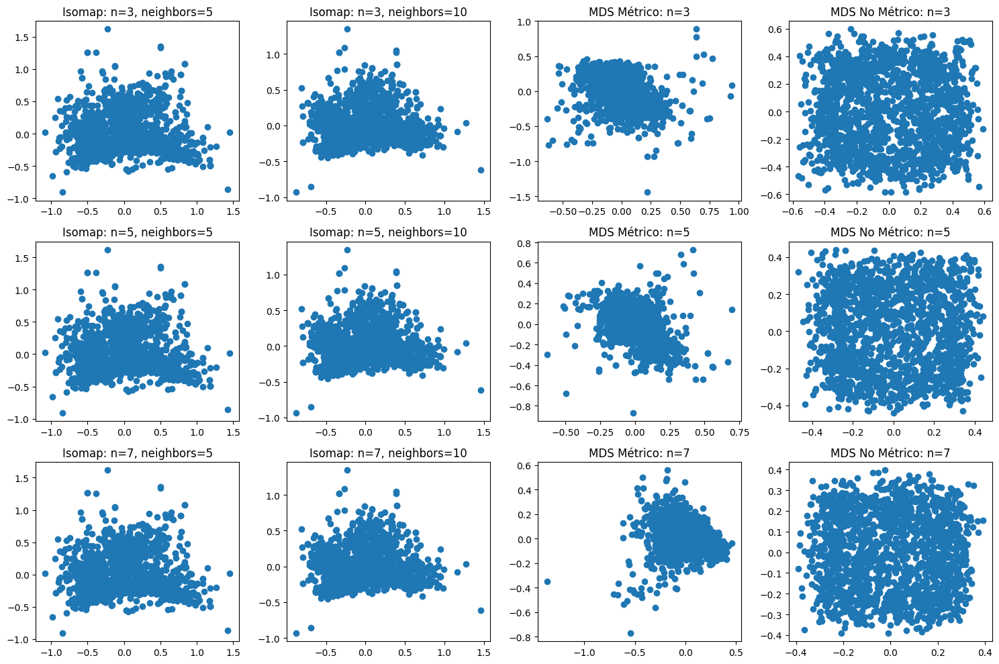

In [44]:
import matplotlib.pyplot as plt

def visualize_dimensionality_reduction_results(results, n_components, n_neighbors_isomap, figsize=(15, 10)):
    """
    Visualiza los resultados de reducción de dimensionalidad usando Isomap y MDS
    """
    fig, axs = plt.subplots(len(n_components), len(n_neighbors_isomap) + 2, figsize=figsize)

    for i, n in enumerate(n_components):
        for j, neighbors in enumerate(n_neighbors_isomap):
            ax = axs[i, j]
            data_isomap = results[f'Isomap (n={n}, neighbors={neighbors})']
            ax.scatter(data_isomap[:, 0], data_isomap[:, 1])
            ax.set_title(f'Isomap: n={n}, neighbors={neighbors}')

        # Visualizacion del MDS Metrico
        ax = axs[i, -2]
        data_mds_metric = results[f'MDS (n={n}, Métrico)']
        ax.scatter(data_mds_metric[:, 0], data_mds_metric[:, 1])
        ax.set_title(f'MDS Métrico: n={n}')

        # Visualización de MDS No Métrico
        ax = axs[i, -1]
        data_mds_nonmetric = results[f'MDS (n={n}, No Métrico)']
        ax.scatter(data_mds_nonmetric[:, 0], data_mds_nonmetric[:, 1])
        ax.set_title(f'MDS No Métrico: n={n}')

    plt.tight_layout()
    plt.show()

visualize_dimensionality_reduction_results(results, n_components, n_neighbors_isomap)

# KMeans

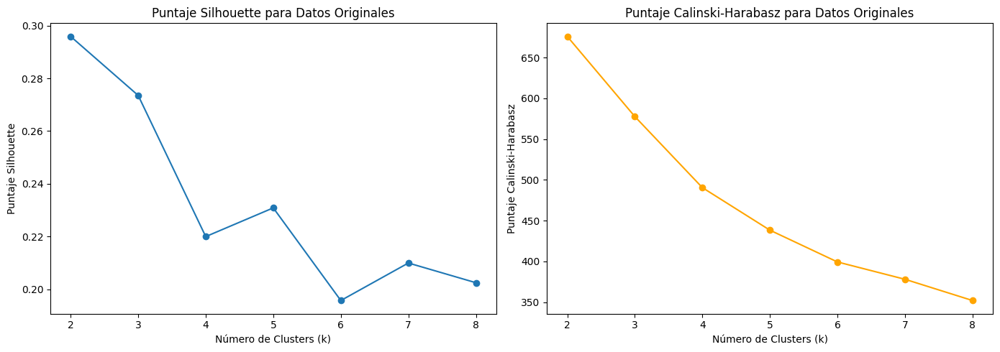

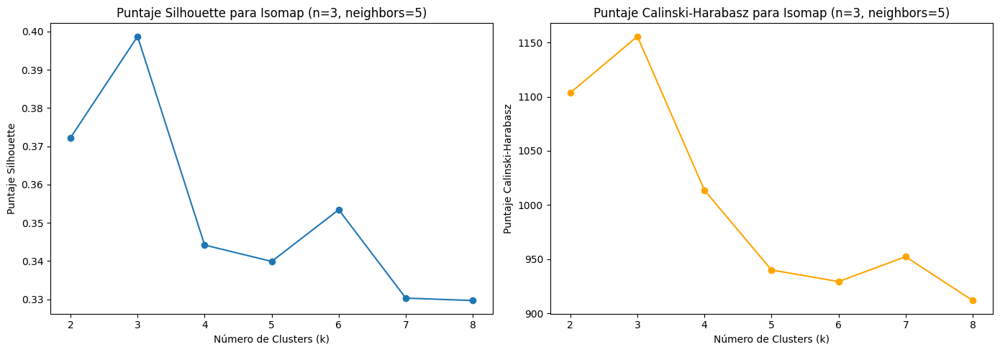

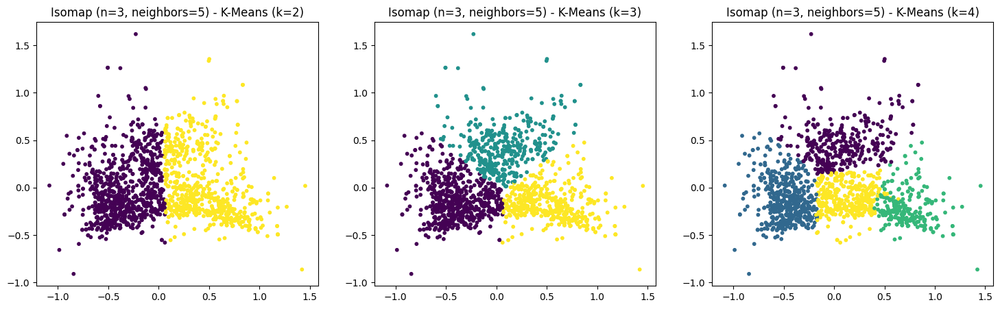

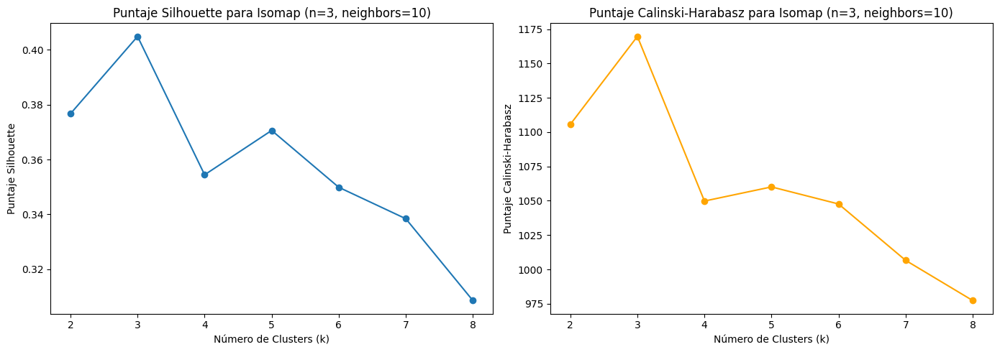

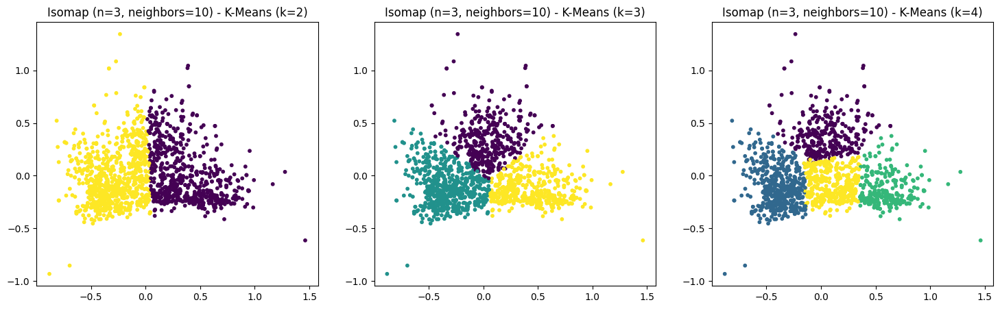

...

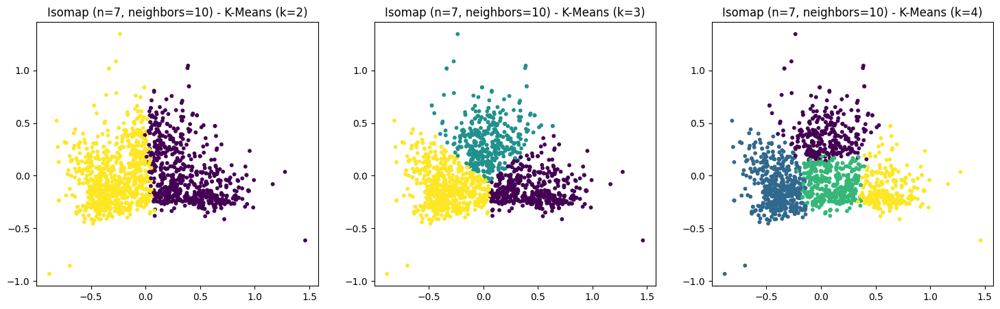

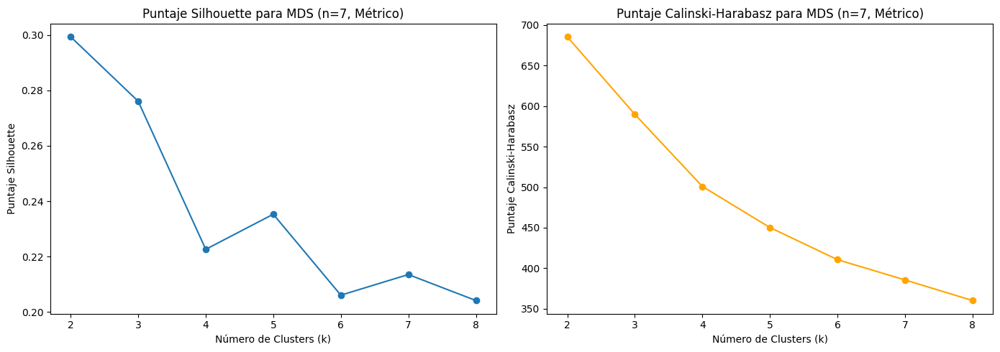

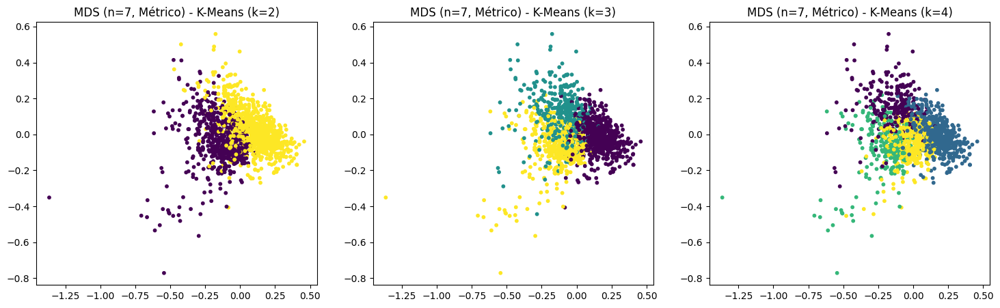

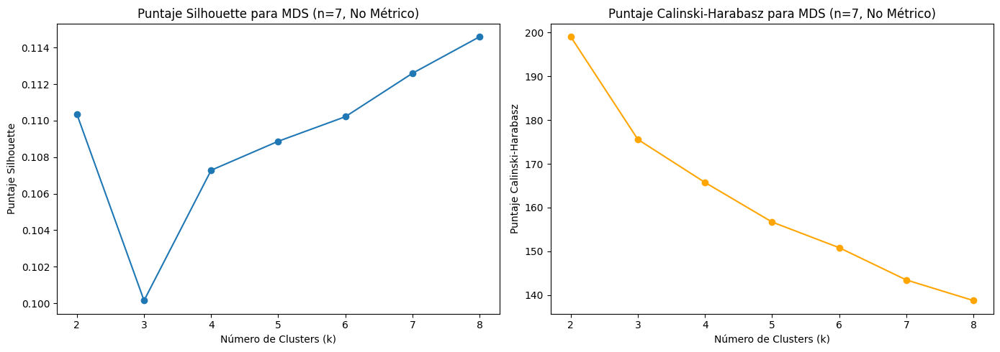

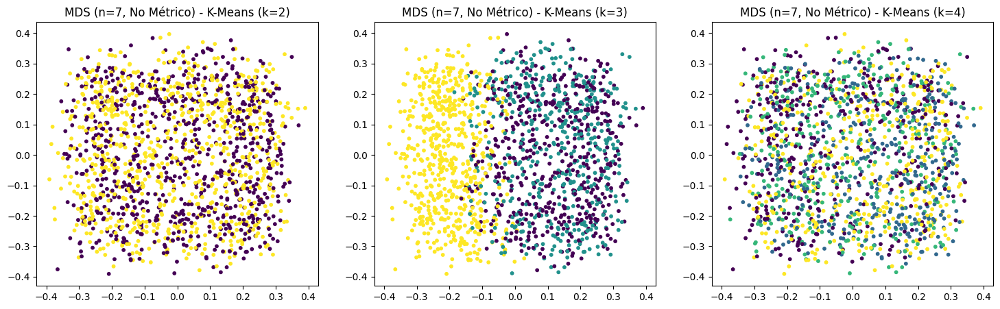

In [51]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import warnings

warnings.filterwarnings("ignore")

#Diccionaro para almacenar métricas de clustering para cada configuración
clustering_metrics = {}

# Función para aplicar K-Means y calcular métricas
def apply_clustering(data, n_clusters, reduction_key, random_state=42):
    clustering_results = {}
    for k in n_clusters:
        model = KMeans(n_clusters=k, init='k-means++', random_state=random_state)
        labels = model.fit_predict(data)
        silhouette_avg = silhouette_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
        clustering_results[k] = (labels, silhouette_avg, calinski_harabasz)

        # Almacenar las métricas en el diccionario global
        if reduction_key not in clustering_metrics:
            clustering_metrics[reduction_key] = {}
        clustering_metrics[reduction_key][k] = (silhouette_avg, calinski_harabasz)

    return clustering_results

# Función para graficar las métricas de clusterización
def plot_clustering_metrics(clustering_results, description):
    k_values = list(clustering_results.keys())
    silhouette_scores = [clustering_results[k][1] for k in k_values]
    calinski_harabasz_scores = [clustering_results[k][2] for k in k_values]

    # Crear gráficos para Silhouette y Calinski-Harabasz
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # Gráfico de Silhouette Score
    axs[0].plot(k_values, silhouette_scores, marker='o')
    axs[0].set_xlabel("Número de Clusters (k)")
    axs[0].set_ylabel("Puntaje Silhouette")
    axs[0].set_title(f"Puntaje Silhouette para {description}")

    # Gráfico de Calinski-Harabasz Score
    axs[1].plot(k_values, calinski_harabasz_scores, marker='o', color='orange')
    axs[1].set_xlabel("Número de Clusters (k)")
    axs[1].set_ylabel("Puntaje Calinski-Harabasz")
    axs[1].set_title(f"Puntaje Calinski-Harabasz para {description}")

    plt.tight_layout()
    plt.show()

# Función para graficar los resultados de la clusterización en el espacio reducido
def plot_clustering_results(ax, data_reduced, labels, title):
    ax.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis', s=10)
    ax.set_title(title)

# Función principal para aplicar reducción de dimensionalidad, clustering y visualizar resultados
def dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized):
    # Aplicar clusterización a los datos originales
    original_clustering_results = apply_clustering(data_normalized, n_clusters, "Datos Originales")
    plot_clustering_metrics(original_clustering_results, "Datos Originales")

    # Graficar los resultados para cada configuración de reducción de dimensionalidad
    for n in n_components:
        for neighbors in n_neighbors_isomap:
            key = f'Isomap (n={n}, neighbors={neighbors})'
            data_reduced = results[key]
            reduced_clustering_results = apply_clustering(data_reduced, n_clusters, key)

            # Gráficos de métricas para cada configuración
            plot_clustering_metrics(reduced_clustering_results, key)

            # Visualización de clustering en el espacio reducido para 3 valores de k (por ejemplo, k=2, k=3, y k=4)
            fig, axs = plt.subplots(1, 3, figsize=(18, 5))
            k_values_for_visuals = [2, 3, 4]
            for i, k in enumerate(k_values_for_visuals):
                labels = reduced_clustering_results[k][0]
                plot_clustering_results(axs[i], data_reduced, labels, f'{key} - K-Means (k={k})')
            plt.show()

        # MDS Métrico
        key = f'MDS (n={n}, Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - K-Means (k={k})')
        plt.show()

        # MDS No Métrico
        key = f'MDS (n={n}, No Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS No Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - K-Means (k={k})')
        plt.show()

# Parámetros de número de clusters
n_clusters = [2, 3, 4, 5, 6, 7, 8]  # Número de clusters para K-Means (puedes ajustar estos valores)

# Ejecuta la función con los resultados de reducción de dimensionalidad y clustering
dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized)

#Mejor Esquema de Clasificacion (KMeans)

In [52]:
# Función para encontrar el mejor esquema de clustering
def find_best_scheme_kmeans(clustering_metrics, reduction_errors):
    best_scheme = None
    best_score = -np.inf

    for reduction_key, metrics in clustering_metrics.items():
        # Obtiene el error de reducción de dimensionalidad
        reduction_error = reduction_errors.get(reduction_key, 0)

        for k, (silhouette_avg, calinski_harabasz) in metrics.items():
            # Calcular un puntaje combinado para cada esquema (mayor es mejor)
            score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

            # Actualiza el mejor esquema si encuentra un puntaje más alto
            if score > best_score:
                best_score = score
                best_scheme = (reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_scheme

# Encuentra el mejor esquema de clasificación
best_scheme_kmeans = find_best_scheme_kmeans(clustering_metrics, reduction_errors)

# Muestra el mejor esquema encontrado
print("Mejor esquema de clasificación (KMeans):")
print(f"Reducción de Dimensionalidad: {best_scheme_kmeans[0]}")
print(f"Número de Clusters (k): {best_scheme_kmeans[1]}")
print(f"Puntaje Silhouette Promedio: {best_scheme_kmeans[2]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_scheme_kmeans[3]:.2f}")
print(f"Error de Reducción: {best_scheme_kmeans[4]:.2f}")

Mejor esquema de clasificación (KMeans):
Reducción de Dimensionalidad: Isomap (n=3, neighbors=10)
Número de Clusters (k): 3
Puntaje Silhouette Promedio: 0.40
Puntaje Calinski-Harabasz Promedio: 1169.67
Error de Reducción: 0.17


#Hierarchical Clustering

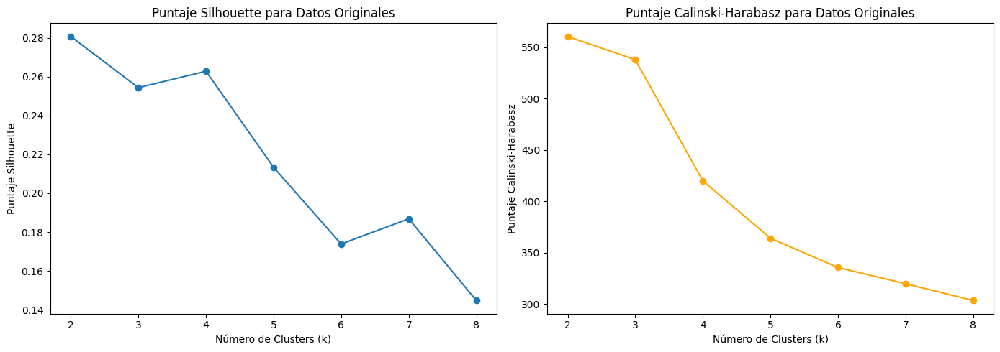

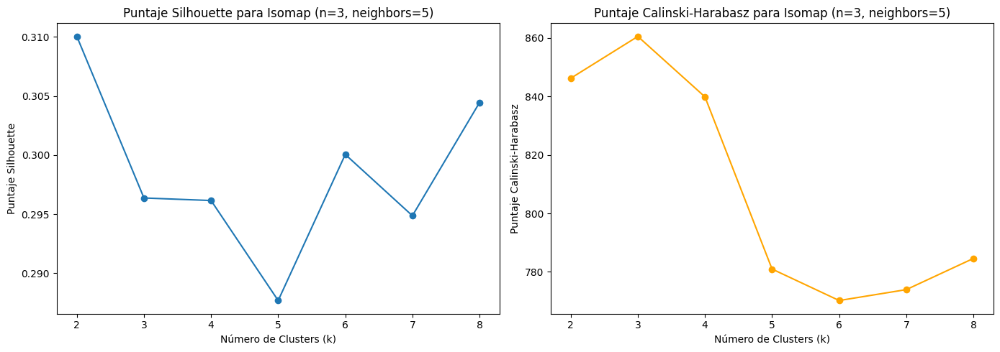

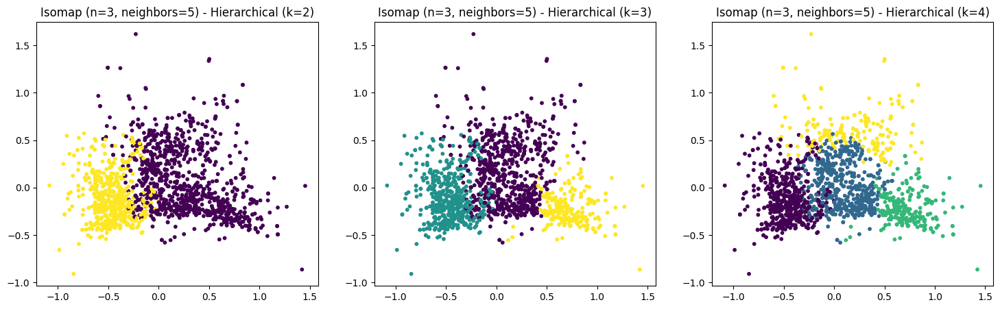

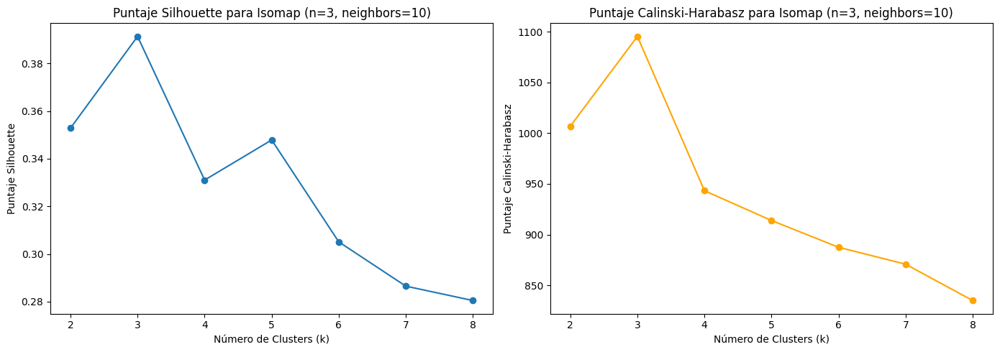

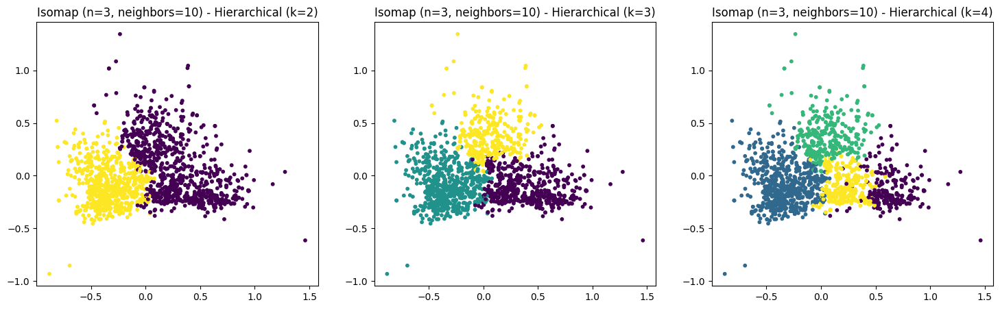

...

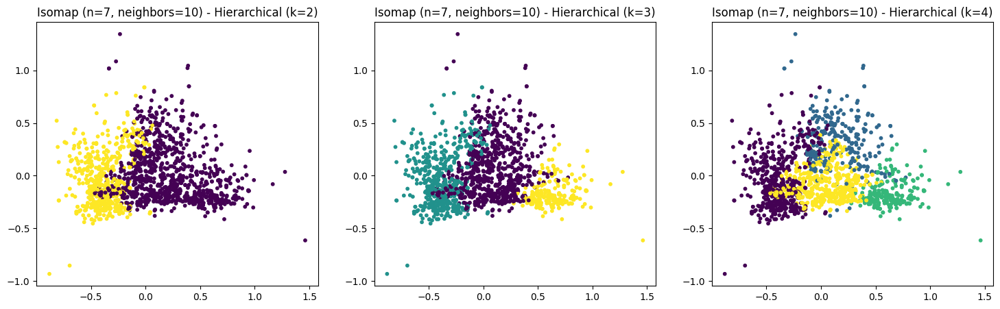

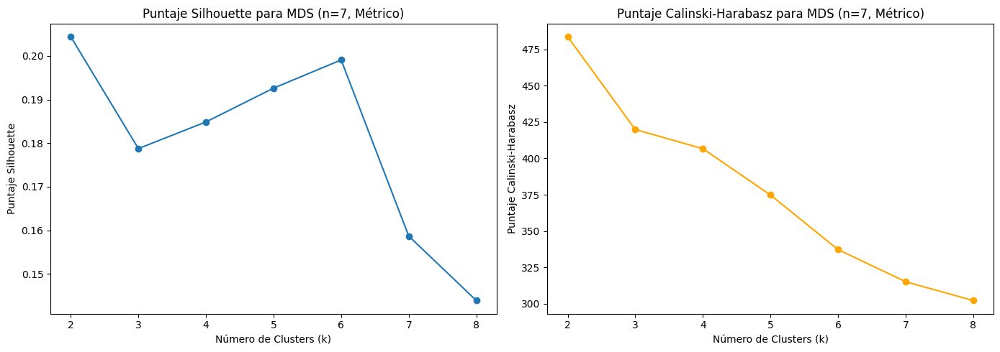

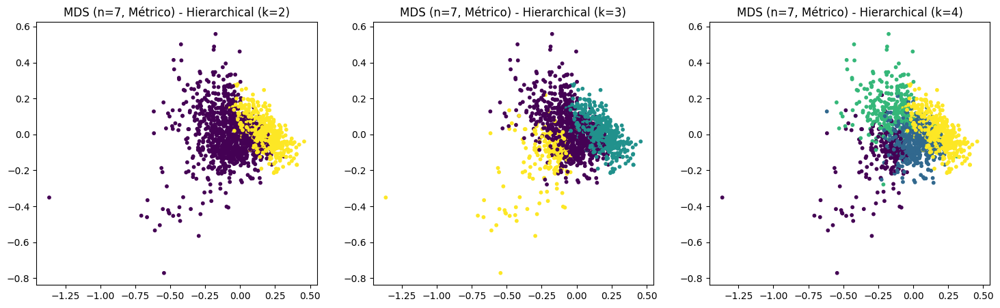

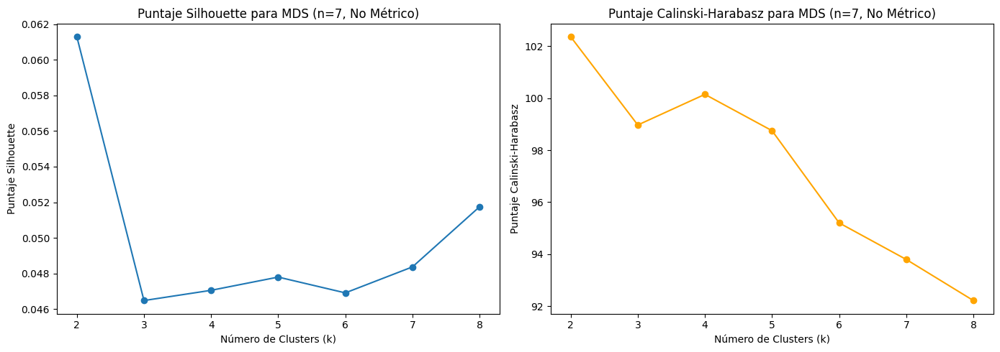

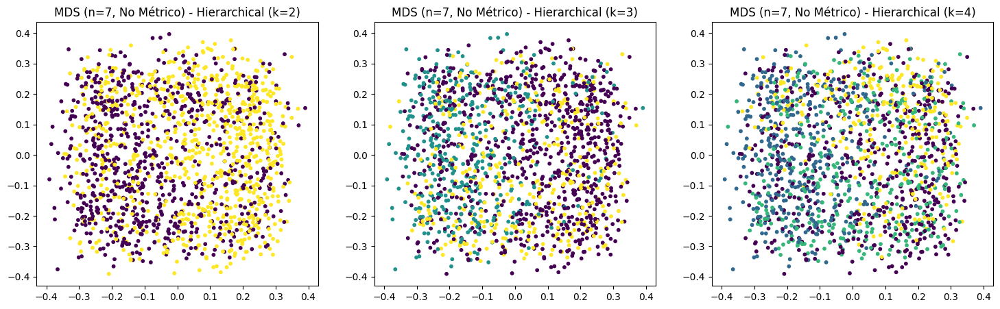

In [53]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import warnings

warnings.filterwarnings("ignore")

# Diccionario para almacenar métricas de clustering para cada configuración
clustering_metrics_hierarchical = {}

# Función para aplicar Hierarchical Clustering y calcular métricas
def apply_hierarchical_clustering(data, n_clusters, reduction_key):
    clustering_results = {}
    for k in n_clusters:
        model = AgglomerativeClustering(n_clusters=k)
        labels = model.fit_predict(data)
        silhouette_avg = silhouette_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
        clustering_results[k] = (labels, silhouette_avg, calinski_harabasz)

        # Almacenar las métricas en el diccionario global
        if reduction_key not in clustering_metrics_hierarchical:
            clustering_metrics_hierarchical[reduction_key] = {}
        clustering_metrics_hierarchical[reduction_key][k] = (silhouette_avg, calinski_harabasz)

    return clustering_results

# Función para graficar las métricas de clusterización
def plot_clustering_metrics(clustering_results, description):
    k_values = list(clustering_results.keys())
    silhouette_scores = [clustering_results[k][1] for k in k_values]
    calinski_harabasz_scores = [clustering_results[k][2] for k in k_values]

    # Crear gráficos para Silhouette y Calinski-Harabasz
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # Gráfico de Silhouette Score
    axs[0].plot(k_values, silhouette_scores, marker='o')
    axs[0].set_xlabel("Número de Clusters (k)")
    axs[0].set_ylabel("Puntaje Silhouette")
    axs[0].set_title(f"Puntaje Silhouette para {description}")

    # Gráfico de Calinski-Harabasz Score
    axs[1].plot(k_values, calinski_harabasz_scores, marker='o', color='orange')
    axs[1].set_xlabel("Número de Clusters (k)")
    axs[1].set_ylabel("Puntaje Calinski-Harabasz")
    axs[1].set_title(f"Puntaje Calinski-Harabasz para {description}")

    plt.tight_layout()
    plt.show()

# Función para graficar los resultados de la clusterización en el espacio reducido
def plot_clustering_results(ax, data_reduced, labels, title):
    ax.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis', s=10)
    ax.set_title(title)

# Función principal para aplicar reducción de dimensionalidad, clustering y visualizar resultados
def dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized):
    # Aplicar clusterización a los datos originales
    original_clustering_results = apply_hierarchical_clustering(data_normalized, n_clusters, "Datos Originales")
    plot_clustering_metrics(original_clustering_results, "Datos Originales")

    # Graficar los resultados para cada configuración de reducción de dimensionalidad
    for n in n_components:
        for neighbors in n_neighbors_isomap:
            key = f'Isomap (n={n}, neighbors={neighbors})'
            data_reduced = results[key]
            reduced_clustering_results = apply_hierarchical_clustering(data_reduced, n_clusters, key)

            # Gráficos de métricas para cada configuración
            plot_clustering_metrics(reduced_clustering_results, key)

            # Visualización de clustering en el espacio reducido para 3 valores de k (por ejemplo, k=2, k=3, y k=4)
            fig, axs = plt.subplots(1, 3, figsize=(18, 5))
            k_values_for_visuals = [2, 3, 4]
            for i, k in enumerate(k_values_for_visuals):
                labels = reduced_clustering_results[k][0]
                plot_clustering_results(axs[i], data_reduced, labels, f'{key} - Hierarchical (k={k})')
            plt.show()

        # MDS Métrico
        key = f'MDS (n={n}, Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_hierarchical_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - Hierarchical (k={k})')
        plt.show()

        # MDS No Métrico
        key = f'MDS (n={n}, No Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_hierarchical_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS No Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - Hierarchical (k={k})')
        plt.show()

# Parámetros de número de clusters
n_clusters = [2, 3, 4, 5, 6, 7, 8]  # Número de clusters para Agglomerative Clustering

# Ejecuta la función con los resultados de reducción de dimensionalidad y clustering
dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized)

#Mejor Esquema (Hierarchical)

In [54]:
# Función para encontrar el mejor esquema de clustering
def find_best_scheme_hierarchical(clustering_metrics_hierarchical, reduction_errors):
    best_scheme = None
    best_score = -np.inf

    for reduction_key, metrics in clustering_metrics_hierarchical.items():
        # Obtiene el error de reducción de dimensionalidad
        reduction_error = reduction_errors.get(reduction_key, 0)

        for k, (silhouette_avg, calinski_harabasz) in metrics.items():
            # Calcular un puntaje combinado para cada esquema (mayor es mejor)
            score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

            # Actualiza el mejor esquema si encuentra un puntaje más alto
            if score > best_score:
                best_score = score
                best_scheme = (reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_scheme

# Encuentra el mejor esquema de clasificación
best_scheme_hierarchical = find_best_scheme_hierarchical(clustering_metrics_hierarchical, reduction_errors)

# Muestra el mejor esquema encontrado
print("Mejor esquema de clasificación (Hierarchical):")
print(f"Reducción de Dimensionalidad: {best_scheme_hierarchical[0]}")
print(f"Número de Clusters (k): {best_scheme_hierarchical[1]}")
print(f"Puntaje Silhouette Promedio: {best_scheme_hierarchical[2]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_scheme_hierarchical[3]:.2f}")
print(f"Error de Reducción: {best_scheme_hierarchical[4]:.2f}")

Mejor esquema de clasificación (Hierarchical):
Reducción de Dimensionalidad: Isomap (n=3, neighbors=10)
Número de Clusters (k): 3
Puntaje Silhouette Promedio: 0.39
Puntaje Calinski-Harabasz Promedio: 1095.33
Error de Reducción: 0.17


#GMM

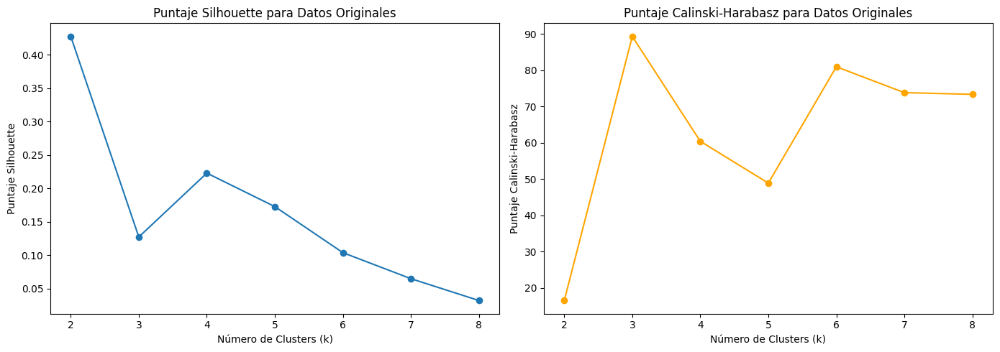

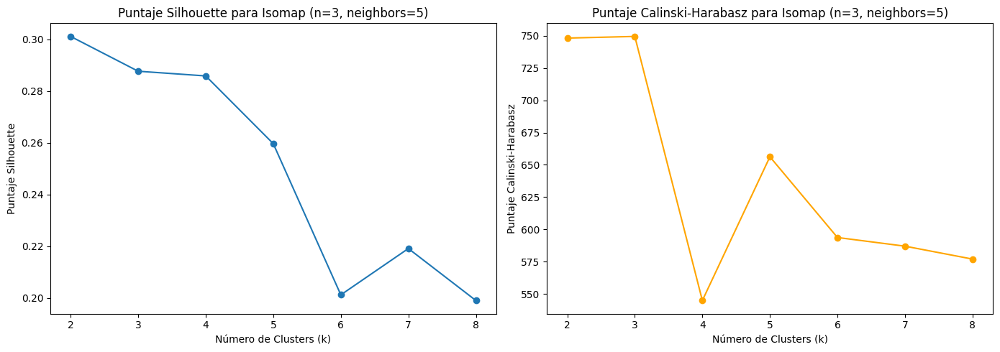

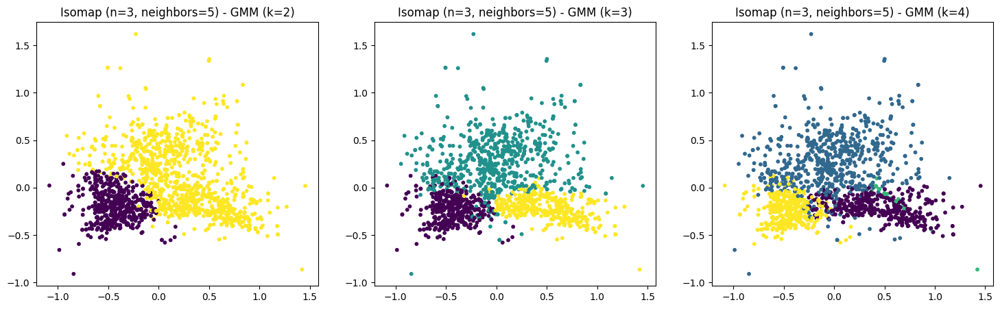

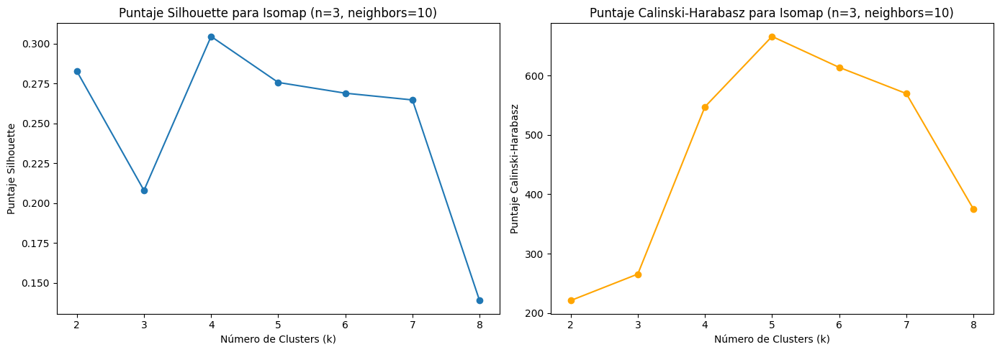

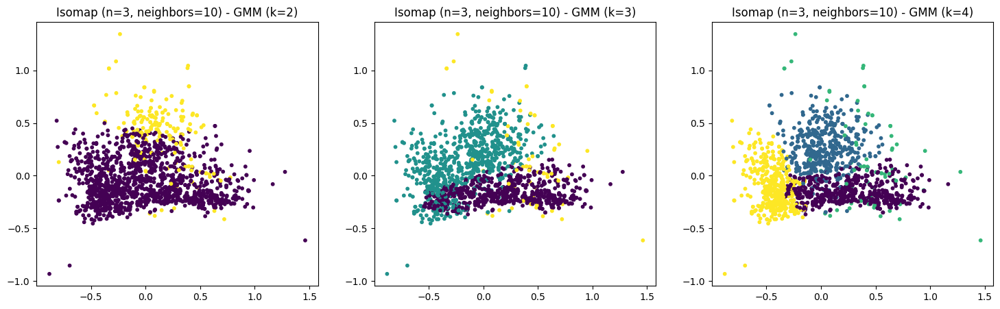

...

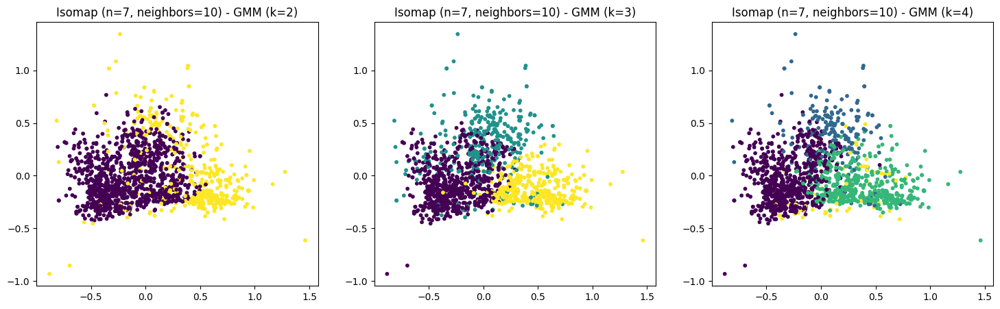

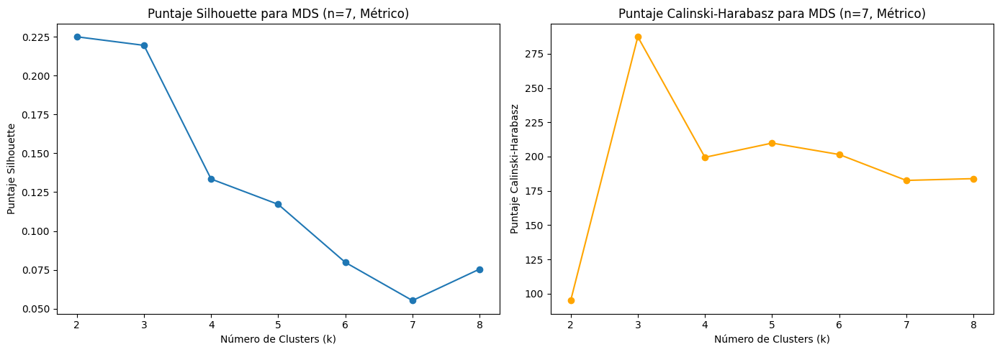

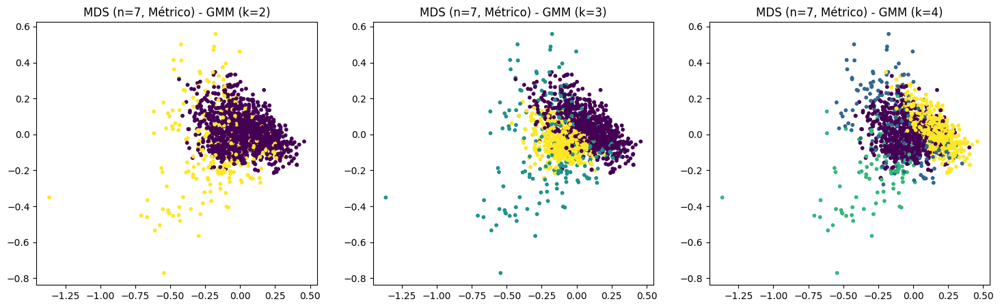

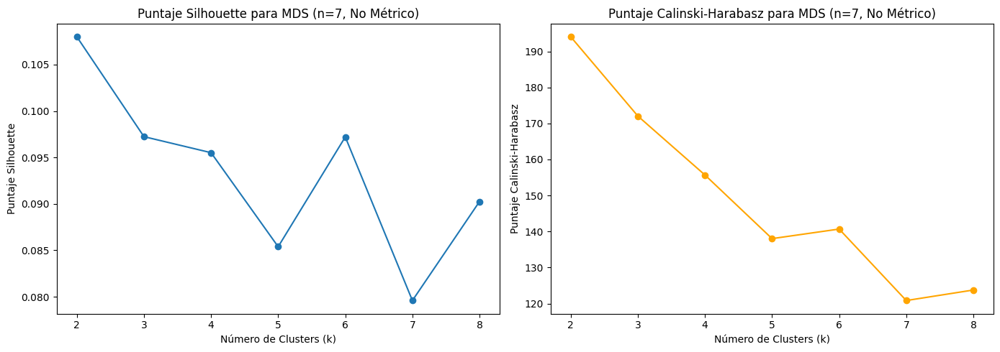

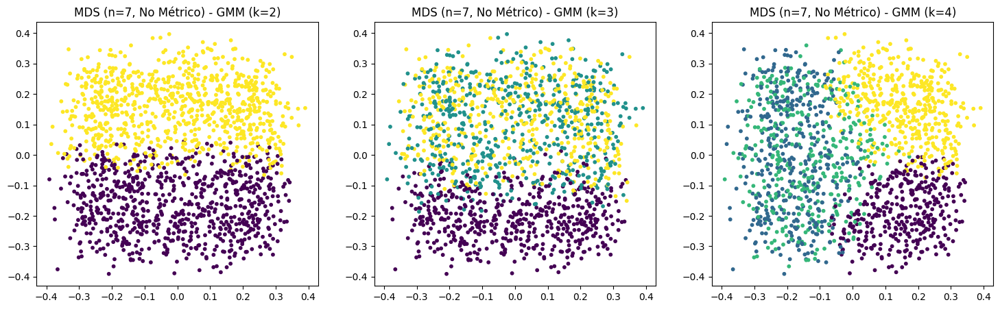

In [55]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import warnings

warnings.filterwarnings("ignore")

# Diccionario para almacenar métricas de clustering para cada configuración
clustering_metrics_gmm = {}

# Función para aplicar Gaussian Mixture Models (GMM) y calcular métricas
def apply_gmm_clustering(data, n_clusters, reduction_key, random_state=42):
    clustering_results = {}
    for k in n_clusters:
        model = GaussianMixture(n_components=k, random_state=random_state)
        labels = model.fit_predict(data)
        silhouette_avg = silhouette_score(data, labels)
        calinski_harabasz = calinski_harabasz_score(data, labels)
        clustering_results[k] = (labels, silhouette_avg, calinski_harabasz)

        # Almacenar las métricas en el diccionario global
        if reduction_key not in clustering_metrics_gmm:
            clustering_metrics_gmm[reduction_key] = {}
        clustering_metrics_gmm[reduction_key][k] = (silhouette_avg, calinski_harabasz)

    return clustering_results

# Función para graficar las métricas de clusterización
def plot_clustering_metrics(clustering_results, description):
    k_values = list(clustering_results.keys())
    silhouette_scores = [clustering_results[k][1] for k in k_values]
    calinski_harabasz_scores = [clustering_results[k][2] for k in k_values]

    # Crear gráficos para Silhouette y Calinski-Harabasz
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # Gráfico de Silhouette Score
    axs[0].plot(k_values, silhouette_scores, marker='o')
    axs[0].set_xlabel("Número de Clusters (k)")
    axs[0].set_ylabel("Puntaje Silhouette")
    axs[0].set_title(f"Puntaje Silhouette para {description}")

    # Gráfico de Calinski-Harabasz Score
    axs[1].plot(k_values, calinski_harabasz_scores, marker='o', color='orange')
    axs[1].set_xlabel("Número de Clusters (k)")
    axs[1].set_ylabel("Puntaje Calinski-Harabasz")
    axs[1].set_title(f"Puntaje Calinski-Harabasz para {description}")

    plt.tight_layout()
    plt.show()

# Función para graficar los resultados de la clusterización en el espacio reducido
def plot_clustering_results(ax, data_reduced, labels, title):
    ax.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis', s=10)
    ax.set_title(title)

# Función principal para aplicar reducción de dimensionalidad, clustering y visualizar resultados
def dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized):
    # Aplicar clusterización a los datos originales
    original_clustering_results = apply_gmm_clustering(data_normalized, n_clusters, "Datos Originales")
    plot_clustering_metrics(original_clustering_results, "Datos Originales")

    # Graficar los resultados para cada configuración de reducción de dimensionalidad
    for n in n_components:
        for neighbors in n_neighbors_isomap:
            key = f'Isomap (n={n}, neighbors={neighbors})'
            data_reduced = results[key]
            reduced_clustering_results = apply_gmm_clustering(data_reduced, n_clusters, key)

            # Gráficos de métricas para cada configuración
            plot_clustering_metrics(reduced_clustering_results, key)

            # Visualización de clustering en el espacio reducido para 3 valores de k (por ejemplo, k=2, k=3, y k=4)
            fig, axs = plt.subplots(1, 3, figsize=(18, 5))
            k_values_for_visuals = [2, 3, 4]
            for i, k in enumerate(k_values_for_visuals):
                labels = reduced_clustering_results[k][0]
                plot_clustering_results(axs[i], data_reduced, labels, f'{key} - GMM (k={k})')
            plt.show()

        # MDS Métrico
        key = f'MDS (n={n}, Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_gmm_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - GMM (k={k})')
        plt.show()

        # MDS No Métrico
        key = f'MDS (n={n}, No Métrico)'
        data_reduced = results[key]
        reduced_clustering_results = apply_gmm_clustering(data_reduced, n_clusters, key)

        # Gráficos de métricas para MDS No Métrico
        plot_clustering_metrics(reduced_clustering_results, key)

        # Visualización de clustering en el espacio reducido para 3 valores de k (k=2, k=3, y k=4)
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, k in enumerate(k_values_for_visuals):
            labels = reduced_clustering_results[k][0]
            plot_clustering_results(axs[i], data_reduced, labels, f'{key} - GMM (k={k})')
        plt.show()

# Parámetros de número de clusters
n_clusters = [2, 3, 4, 5, 6, 7, 8]  # Número de clusters para GMM

# Ejecuta la función con los resultados de reducción de dimensionalidad y clustering
dimensionality_reduction_clustering_with_visuals(results, n_components, n_neighbors_isomap, n_clusters, data_normalized)

#Mejor Esquema (GMM)

In [56]:
# Función para encontrar el mejor esquema de clustering para GMM
def find_best_scheme_gmm(clustering_metrics_gmm, reduction_errors):
    best_scheme = None
    best_score = -np.inf

    for reduction_key, metrics in clustering_metrics_gmm.items():
        # Obtiene el error de reducción de dimensionalidad
        reduction_error = reduction_errors.get(reduction_key, 0)

        for k, (silhouette_avg, calinski_harabasz) in metrics.items():
            # Calcular un puntaje combinado para cada esquema (mayor es mejor)
            score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

            # Actualiza el mejor esquema si encuentra un puntaje más alto
            if score > best_score:
                best_score = score
                best_scheme = (reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_scheme

# Encuentra el mejor esquema de clasificación en GMM
best_scheme_gmm = find_best_scheme_gmm(clustering_metrics_gmm, reduction_errors)

# Muestra el mejor esquema encontrado
print("Mejor esquema de clasificación (GMM):")
print(f"Reducción de Dimensionalidad: {best_scheme_gmm[0]}")
print(f"Número de Clusters (k): {best_scheme_gmm[1]}")
print(f"Puntaje Silhouette Promedio: {best_scheme_gmm[2]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_scheme_gmm[3]:.2f}")
print(f"Error de Reducción: {best_scheme_gmm[4]:.2f}")

Mejor esquema de clasificación (GMM):
Reducción de Dimensionalidad: Isomap (n=3, neighbors=5)
Número de Clusters (k): 3
Puntaje Silhouette Promedio: 0.29
Puntaje Calinski-Harabasz Promedio: 749.33
Error de Reducción: 0.30


#Mejor Esquema (Overall)

In [57]:
# Función para encontrar el mejor esquema entre los tres algoritmos de clustering
def find_overall_best_scheme(best_scheme_kmeans, best_scheme_hierarchical, best_scheme_gmm):
    # Inicializa variables para el mejor esquema general
    best_overall_scheme = None
    best_score = -np.inf

    # Diccionario con los resultados de los mejores esquemas para cada algoritmo
    best_schemes = {
        "KMeans": best_scheme_kmeans,
        "Hierarchical": best_scheme_hierarchical,
        "GMM": best_scheme_gmm
    }

    # Itera sobre cada esquema y calcula el puntaje combinado para cada uno
    for algorithm, scheme in best_schemes.items():
        reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error = scheme
        score = (silhouette_avg + calinski_harabasz) / 2 - reduction_error

        # Verifica si este esquema es mejor que el actual mejor esquema
        if score > best_score:
            best_score = score
            best_overall_scheme = (algorithm, reduction_key, k, silhouette_avg, calinski_harabasz, reduction_error)

    return best_overall_scheme

# Encuentra el mejor esquema entre los resultados de KMeans, Hierarchical y GMM
best_overall_scheme = find_overall_best_scheme(best_scheme_kmeans, best_scheme_hierarchical, best_scheme_gmm)

# Muestra el mejor esquema general encontrado
print("Mejor esquema de clasificación entre los tres algoritmos:")
print(f"Algoritmo: {best_overall_scheme[0]}")
print(f"Reducción de Dimensionalidad: {best_overall_scheme[1]}")
print(f"Número de Clusters (k): {best_overall_scheme[2]}")
print(f"Puntaje Silhouette Promedio: {best_overall_scheme[3]:.2f}")
print(f"Puntaje Calinski-Harabasz Promedio: {best_overall_scheme[4]:.2f}")
print(f"Error de Reducción: {best_overall_scheme[5]:.2f}")

Mejor esquema de clasificación entre los tres algoritmos:
Algoritmo: KMeans
Reducción de Dimensionalidad: Isomap (n=3, neighbors=10)
Número de Clusters (k): 3
Puntaje Silhouette Promedio: 0.40
Puntaje Calinski-Harabasz Promedio: 1169.67
Error de Reducción: 0.17


___

## **Importar Librerías y Cargar Datos**

In [ ]:
import pandas as pd
import numpy as np
from joblib import Parallel, delayed
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.manifold import Isomap, MDS
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score
import matplotlib.pyplot as plt
from IPython.display import display
import pandas as pd

def load_data(filepath):
    """Carga los datos desde un archivo Excel"""
    df = pd.read_excel(filepath)
    return df

def scale_data(df):
    """Escala los datos utilizando StandardScaler"""
    scaler = StandardScaler()
    data_scaled = scaler.fit_transform(df)
    return data_scaled

def normalize_data(df):
    """Normaliza los datos utilizando MinMaxScaler para llevarlos al rango [0, 1]"""
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_normalized = scaler.fit_transform(df)
    return data_normalized

filepath = 'dataset_wq.xlsx'
df = load_data(filepath)
data_scaled = scale_data(df)
data_normalized = normalize_data(data_scaled)

## **Aplicar Isomap y MDS**

In [ ]:
import warnings
warnings.filterwarnings("ignore")

def apply_isomap(data, n, neighbors, path_method='auto'):
    """Aplica Isomap con los parámetros dados"""
    isomap = Isomap(n_components=n, n_neighbors=neighbors, path_method=path_method, n_jobs=1)
    return isomap.fit_transform(data), f'Isomap (n={n}, neighbors={neighbors}, path_method={path_method})'

def apply_mds(data, n, metric, n_init=3, max_iter=500):
    """Aplica MDS con los parámetros dados"""
    mds = MDS(n_components=n, metric=metric, n_init=n_init, max_iter=max_iter, n_jobs=1)
    metric_type = 'Métrico' if metric else 'No Métrico'
    return mds.fit_transform(data), f'MDS {metric_type} (n={n})'

def run_isomap_parallel(data, n_components, n_neighbors_isomap, path_methods=['auto']):
    """Aplica Isomap en paralelo con diferentes configuraciones de parámetros"""
    results = {}
    tasks = [(n, neighbors, path_method) for n in n_components for neighbors in n_neighbors_isomap for path_method in path_methods]

    results_list = Parallel(n_jobs=1, backend='threading')(delayed(apply_isomap)(data, n, neighbors, path_method) for n, neighbors, path_method in tasks)

    for (n, neighbors, path_method), (data_reduced, label) in zip(tasks, results_list):
        results[label] = data_reduced

    return results

def run_mds_parallel(data, n_components, metrics=[True, False], n_init=3, max_iter=200):
    """Aplica MDS en paralelo con diferentes configuraciones de parámetros"""
    results = {}
    tasks = [(n, metric) for n in n_components for metric in metrics]

    results_list = Parallel(n_jobs=1, backend='threading')(delayed(apply_mds)(data, n, metric, n_init, max_iter) for n, metric in tasks)

    for (n, metric), (data_reduced, label) in zip(tasks, results_list):
        results[label] = data_reduced

    return results

n_components = [3, 5, 7]
n_neighbors_isomap = [5, 10]
path_methods = ['auto']
metrics = [True, False]

results_isomap = run_isomap_parallel(data_normalized, n_components, n_neighbors_isomap, path_methods)
results_mds = run_mds_parallel(data_normalized, n_components, metrics, n_init=3, max_iter=200)

## **Visualizar los resultados de reducción de dimensionalidad**

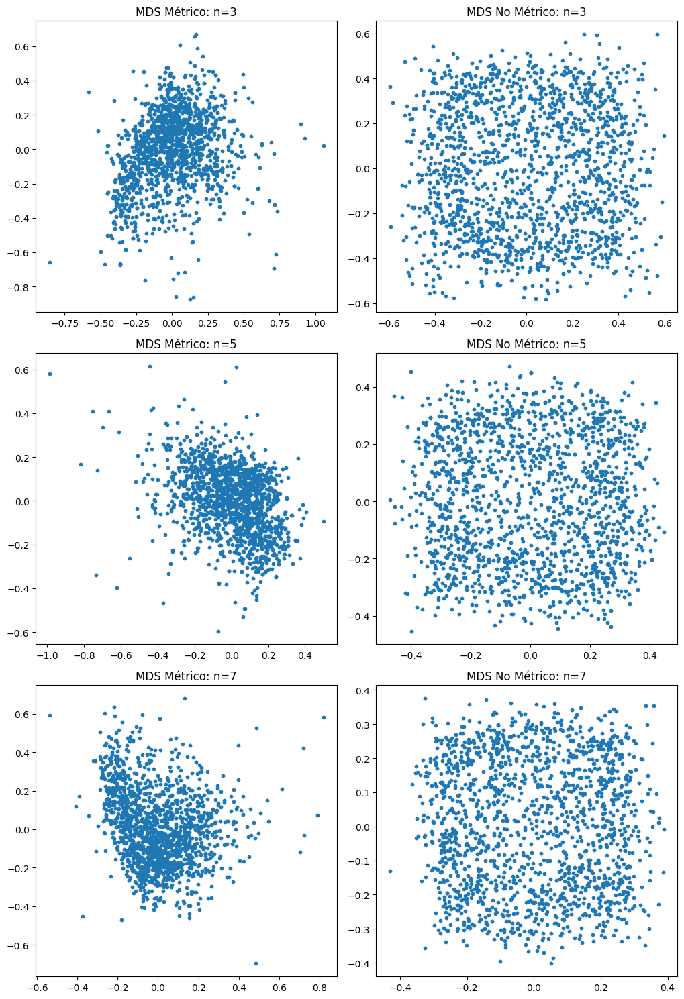

In [ ]:
def visualize_dimensionality_reduction_results(results, n_components, n_neighbors_isomap, figsize=(20, 15)):
    """
    Visualiza los resultados de reducción de dimensionalidad usando Isomap y MDS
    """
    fig, axs = plt.subplots(len(n_components), len(n_neighbors_isomap) + 2, figsize=figsize)

    if len(n_components) == 1:
        axs = [axs]

    for i, n in enumerate(n_components):
        for j, neighbors in enumerate(n_neighbors_isomap):
            ax = axs[i][j]
            label = f'Isomap (n={n}, neighbors={neighbors}, path_method=dijkstra)'
            if label in results:
                data_isomap = results[label]
                if data_isomap.shape[1] >= 2:
                    ax.scatter(data_isomap[:, 0], data_isomap[:, 1], s=10)
                    ax.set_title(f'Isomap: n={n}, neighbors={neighbors}')
                else:
                    ax.set_visible(False)
            else:
                ax.set_visible(False)

        ax = axs[i][-2]
        label_metric = f'MDS Métrico (n={n})'
        if label_metric in results:
            data_mds_metric = results[label_metric]
            if data_mds_metric.shape[1] >= 2:
                ax.scatter(data_mds_metric[:, 0], data_mds_metric[:, 1], s=10)
                ax.set_title(f'MDS Métrico: n={n}')
            else:
                ax.set_visible(False)
        else:
            ax.set_visible(False)

        ax = axs[i][-1]
        label_nonmetric = f'MDS No Métrico (n={n})'
        if label_nonmetric in results:
            data_mds_nonmetric = results[label_nonmetric]
            if data_mds_nonmetric.shape[1] >= 2:
                ax.scatter(data_mds_nonmetric[:, 0], data_mds_nonmetric[:, 1], s=10)
                ax.set_title(f'MDS No Métrico: n={n}')
            else:
                ax.set_visible(False)
        else:
            ax.set_visible(False)

    plt.tight_layout()
    plt.show()

results = {**results_isomap, **results_mds}
visualize_dimensionality_reduction_results(results, n_components, n_neighbors_isomap)

## **Aplicar K-Means**

In [ ]:
def apply_kmeans_parallel(data, k_range=range(2, 9), n_init=10):
    def kmeans_clustering(k):
        if data is not None and len(data) > 0 and data.shape[1] >= 2:
            kmeans = KMeans(n_clusters=k, init='k-means++', n_init=n_init, max_iter=300, random_state=42)
            labels = kmeans.fit_predict(data)
            silhouette = silhouette_score(data, labels)
            ch_score = calinski_harabasz_score(data, labels)
            return f'K-Means (k={k})', labels, silhouette, ch_score
        else:
            return f'K-Means (k={k})', None, None, None

    results = Parallel(n_jobs=-1)(delayed(kmeans_clustering)(k) for k in k_range)
    return {key: (data, labels, silhouette, ch_score) for key, labels, silhouette, ch_score in results if labels is not None}

In [ ]:
# Aplicar K-Means con Isomap
kmeans_results_isomap = {}
for label, data_isomap in results_isomap.items():
    kmeans_results = apply_kmeans_parallel(data_isomap)
    for key, value in kmeans_results.items():
        label_clean = label.replace(", path_method=dijkstra", "")
        kmeans_results_isomap[f'{label_clean} - {key}'] = value
        print(f'{label_clean} - {key}: Silhouette = {value[2]:.2f}, Calinski-Harabasz = {value[3]:.2f}')

Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=2): Silhouette = 0.37, Calinski-Harabasz = 1103.56
Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=3): Silhouette = 0.40, Calinski-Harabasz = 1155.56
Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=4): Silhouette = 0.34, Calinski-Harabasz = 1013.66
Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=5): Silhouette = 0.34, Calinski-Harabasz = 940.06
Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=6): Silhouette = 0.35, Calinski-Harabasz = 929.39
Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=7): Silhouette = 0.33, Calinski-Harabasz = 952.33
Isomap (n=3, neighbors=5, path_method=auto) - K-Means (k=8): Silhouette = 0.33, Calinski-Harabasz = 911.90
Isomap (n=3, neighbors=10, path_method=auto) - K-Means (k=2): Silhouette = 0.38, Calinski-Harabasz = 1105.64
Isomap (n=3, neighbors=10, path_method=auto) - K-Means (k=3): Silhouette = 0.40, Calinski-Harabasz = 1169.67
Isomap (n=3, neighbors=10, pat

In [ ]:
# Mostrar los resultados de Isomap
dataframe_results_isomap = pd.DataFrame(
    [(label, f'{value[2]:.2f}', f'{value[3]:.2f}') for label, value in kmeans_results_isomap.items() if value[2] is not None and value[3] is not None],
    columns=['Método', 'Silhouette Score', 'Calinski-Harabasz Score']
)
display(dataframe_results_isomap)

,Método,Silhouette Score,Calinski-Harabasz Score
0,"Isomap (n=3, neighbors=5) - K-Means (k=2)",0.37,1103.56
1,"Isomap (n=3, neighbors=5) - K-Means (k=3)",0.40,1155.56
2,"Isomap (n=3, neighbors=5) - K-Means (k=4)",0.34,1013.66
3,"Isomap (n=3, neighbors=5) - K-Means (k=5)",0.34,941.21
4,"Isomap (n=3, neighbors=5) - K-Means (k=6)",0.32,918.73
5,"Isomap (n=3, neighbors=5) - K-Means (k=7)",0.33,952.33
6,"Isomap (n=3, neighbors=5) - K-Means (k=8)",0.32,912.01
7,"Isomap (n=3, neighbors=10) - K-Means (k=2)",0.38,1105.64
8,"Isomap (n=3, neighbors=10) - K-Means (k=3)",0.40,1169.67
9,"Isomap (n=3, neighbors=10) - K-Means (k=4)",0.35,1049.76


In [ ]:
# Aplicar K-Means con MDS
kmeans_results_mds = {}
for label, data_mds in results_mds.items():
    kmeans_results = apply_kmeans_parallel(data_mds)
    for key, value in kmeans_results.items():
        label_clean = label.replace(", path_method=auto", "")
        kmeans_results_mds[f'{label_clean} - {key}'] = value
        print(f'{label_clean} - {key}: Silhouette = {value[2]:.2f}, Calinski-Harabasz = {value[3]:.4f}')

MDS Métrico (n=3) - K-Means (k=2): Silhouette = 0.30, Calinski-Harabasz = 418.2453
MDS Métrico (n=3) - K-Means (k=3): Silhouette = 0.30, Calinski-Harabasz = 410.7630
MDS Métrico (n=3) - K-Means (k=4): Silhouette = 0.31, Calinski-Harabasz = 422.3985
MDS Métrico (n=3) - K-Means (k=5): Silhouette = 0.32, Calinski-Harabasz = 391.0481
MDS Métrico (n=3) - K-Means (k=6): Silhouette = 0.23, Calinski-Harabasz = 386.5834
MDS Métrico (n=3) - K-Means (k=7): Silhouette = 0.24, Calinski-Harabasz = 389.0834
MDS Métrico (n=3) - K-Means (k=8): Silhouette = 0.24, Calinski-Harabasz = 382.7539
MDS Métrico (n=3) - K-Means (k=9): Silhouette = 0.25, Calinski-Harabasz = 381.0941
MDS Métrico (n=3) - K-Means (k=10): Silhouette = 0.25, Calinski-Harabasz = 380.3050
MDS Métrico (n=3) - K-Means (k=11): Silhouette = 0.25, Calinski-Harabasz = 383.3550
MDS Métrico (n=3) - K-Means (k=12): Silhouette = 0.24, Calinski-Harabasz = 399.4486
MDS Métrico (n=3) - K-Means (k=13): Silhouette = 0.25, Calinski-Harabasz = 402.2615


In [ ]:
dataframe_results_mds = pd.DataFrame(
    [(label, f'{value[2]:.2f}', f'{value[3]:.2f}') for label, value in kmeans_results_mds.items() if value[2] is not None and value[3] is not None],
    columns=['Método', 'Silhouette Score', 'Calinski-Harabasz Score']
)
display(dataframe_results_mds)

,Método,Silhouette Score,Calinski-Harabasz Score
0,MDS Métrico (n=3) - K-Means (k=2),0.30,418.25
1,MDS Métrico (n=3) - K-Means (k=3),0.30,410.76
2,MDS Métrico (n=3) - K-Means (k=4),0.31,422.40
3,MDS Métrico (n=3) - K-Means (k=5),0.26,374.86
4,MDS Métrico (n=3) - K-Means (k=6),0.23,386.58
5,MDS Métrico (n=3) - K-Means (k=7),0.27,385.75
6,MDS Métrico (n=3) - K-Means (k=8),0.24,382.75
7,MDS No Métrico (n=3) - K-Means (k=2),0.25,549.01
8,MDS No Métrico (n=3) - K-Means (k=3),0.26,576.43
9,MDS No Métrico (n=3) - K-Means (k=4),0.29,639.45


## **Aplicar Clustering Jerárquico**

In [ ]:
def apply_hierarchical_parallel(data, k_range=range(2, 9)):
    """Aplica Clustering Jerárquico al conjunto de datos en paralelo y calcula métricas de evaluación"""
    def hierarchical_clustering(k):
        hierarchical = AgglomerativeClustering(n_clusters=k)
        labels = hierarchical.fit_predict(data)
        silhouette = silhouette_score(data, labels)
        ch_score = calinski_harabasz_score(data, labels)
        return f'Hierarchical (k={k})', labels, silhouette, ch_score

    results = Parallel(n_jobs=-1)(delayed(hierarchical_clustering)(k) for k in k_range)
    return {key: (labels, silhouette, ch_score) for key, labels, silhouette, ch_score in results}

print("\nAplicando Clustering Jerárquico al espacio original de los datos...")
hierarchical_results_original = apply_hierarchical_parallel(data_scaled)
for key, value in hierarchical_results_original.items():
    print(f'{key}: Silhouette = {value[1]:.4f}, Calinski-Harabasz = {value[2]:.4f}')


Aplicando Clustering Jerárquico al espacio original de los datos...
Hierarchical (k=2): Silhouette = 0.1951, Calinski-Harabasz = 241.3505
Hierarchical (k=3): Silhouette = 0.1938, Calinski-Harabasz = 228.2533
Hierarchical (k=4): Silhouette = 0.2021, Calinski-Harabasz = 242.4904
Hierarchical (k=5): Silhouette = 0.2067, Calinski-Harabasz = 269.0623
Hierarchical (k=6): Silhouette = 0.1675, Calinski-Harabasz = 287.9275
Hierarchical (k=7): Silhouette = 0.1856, Calinski-Harabasz = 317.2540
Hierarchical (k=8): Silhouette = 0.1872, Calinski-Harabasz = 328.2945


## **Aplicar GMM**

In [ ]:
def apply_gmm_parallel(data, k_range=range(2, 9)):
    """Aplica GMM al conjunto de datos en paralelo y calcula métricas de evaluación"""
    def gmm_clustering(k):
        gmm = GaussianMixture(n_components=k, random_state=42)
        labels = gmm.fit_predict(data)
        silhouette = silhouette_score(data, labels)
        ch_score = calinski_harabasz_score(data, labels)
        return f'GMM (k={k})', labels, silhouette, ch_score

    results = Parallel(n_jobs=-1)(delayed(gmm_clustering)(k) for k in k_range)
    return {key: (labels, silhouette, ch_score) for key, labels, silhouette, ch_score in results}

print("\nAplicando GMM al espacio original de los datos...")
gmm_results_original = apply_gmm_parallel(data_scaled)
for key, value in gmm_results_original.items():
    print(f'{key}: Silhouette = {value[1]:.4f}, Calinski-Harabasz = {value[2]:.4f}')


Aplicando GMM al espacio original de los datos...
GMM (k=2): Silhouette = 0.7071, Calinski-Harabasz = 76.1813
GMM (k=3): Silhouette = 0.5647, Calinski-Harabasz = 92.9668
GMM (k=4): Silhouette = 0.4245, Calinski-Harabasz = 72.3082
GMM (k=5): Silhouette = 0.1942, Calinski-Harabasz = 97.3379
GMM (k=6): Silhouette = 0.1161, Calinski-Harabasz = 123.8879
GMM (k=7): Silhouette = 0.1511, Calinski-Harabasz = 204.9765
GMM (k=8): Silhouette = 0.1608, Calinski-Harabasz = 277.8577
